we choose the FID score to measure the performance of different models. For baseline model, we use a simple multi-layer CNN that consists of 2 convolution layers.

We use BCEloss as the adversarial loss, and L1Loss as the cycle-consistency loss. 
For D_a, the discriminator for anime, the loss comes from whether it labels true animes correctly, and whether it could recognize fake animes.
Similar for D_s, the discriminator for selfies.

For the generators, the goal is to minimize the adversarial loss (loss1 from D_s) and (loss2 from D_a) AND cycle consistency loss for G_s (loss3) and G_a (loss4).
For G_s, the generator that translates selfie into anime, the loss comes from the generated animes being classified as fake anime (by D_a), and the distance between (G_a(G_s(anime))) and anime, and the distance between (G_s(G_a(selfie))) and selfie.

The network structure for Generators is ResNet. It contains 6 blocks of (Conv,BatchNorm, ReLU, Conv, BatchNorm).

We also tried UNet structure for the generators. It is a U-shaped network that downsamples the input image from 64 by 64 to 4 by 4, and then upsample it while concatenating it with images from previous layers.

# Import

In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import math
import torch.nn.functional as F
import torch.optim.lr_scheduler as lrs
from torch.utils.data import DataLoader
from torch.utils.data import sampler
import torchvision.transforms as transforms
torch.cuda.empty_cache()

# Dataloading

get access to google drive files；
load and normalize the images；

In [ ]:
# get access to google drive files 

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# load and normalize the images 

image_size = 64
batch_size = 8
train_self = dset.ImageFolder(root="./drive/MyDrive/selfie2anime/train_self",
                           transform=transforms.Compose([
                               # transforms.Grayscale(num_output_channels=1),
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5), (0.5)),
                              
                           ]))
loader_train_self = DataLoader(train_self, batch_size, shuffle=True)

test_self = dset.ImageFolder(root="./drive/MyDrive/selfie2anime/test_self",
                           transform=transforms.Compose([
                               # transforms.Grayscale(num_output_channels=1),
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5), (0.5)),
                           ]))
loader_test_self = DataLoader(test_self, batch_size, shuffle=True)

train_anime = dset.ImageFolder(root="./drive/MyDrive/selfie2anime/train_anime",
                           transform=transforms.Compose([
                               # transforms.Grayscale(num_output_channels=1),
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5), (0.5)),
                           ]))
loader_train_anime = DataLoader(train_anime, batch_size, shuffle=True)

test_anime = dset.ImageFolder(root="./drive/MyDrive/selfie2anime/test_anime",
                           transform=transforms.Compose([
                               # transforms.Grayscale(num_output_channels=1),
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5), (0.5)),
                           ]))
loader_test_anime = DataLoader(test_anime, batch_size, shuffle=True)

Here are some sample images from training set.

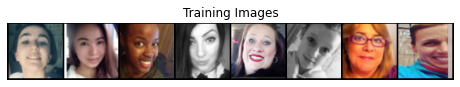

In [ ]:
# display some training selfies 
 
device = "cuda" # cuda 
real_batch = next(iter(loader_train_self))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

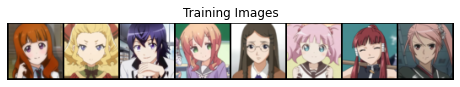

In [ ]:
# display some training animes 

device = 'cuda' #'cuda'
real_batch = next(iter(loader_train_anime))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Baseline

In [ ]:
# preprocess the images as required for pretrained Inception v3 moddel 
preprocess = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])         
# get 100 test animes
testA = []
for i in range(len(test_anime)): 
    image, label = test_anime[i]
    image = preprocess(image)
    testA.append(image.unsqueeze(0)) # (1,3,299,299)
res = torch.Tensor(len(testA), 3, 299, 299)
testA = torch.cat(testA, out=res)[:100]

# get 100 test selfies
testS = []
for i in range(len(test_self)): 
    image, labels = test_self[i]
    image = preprocess(image)
    testS.append(image.unsqueeze(0))  
res = torch.Tensor(len(testS), 3, 299, 299)
testS = torch.cat(testS, out=res)[:100]

# Getting the result of last layer before output layer from inception v3 model as the activations 
# code from https://discuss.pytorch.org/t/extract-the-2048-vector-of-a-fine-tuned-inception-v3-on-test-set/152510/5

activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

# get activation for testing animes 
model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
model.avgpool.register_forward_hook(get_activation("avgpool"))
with torch.no_grad():
  out = model(testA)
activation_a = activation['avgpool'].flatten(start_dim=1) # (100,2048)

# get activation for testing selfies 
model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
model.avgpool.register_forward_hook(get_activation("avgpool"))
with torch.no_grad():
  out = model(testS)
activation_s = activation['avgpool'].flatten(start_dim=1) # (100,2048)


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Here, we choose the FID score to measure the performance of different models.

In [ ]:
# Calculating FID score from two activations, 
# code from https://machinelearningmastery.com/how-to-implement-the-frechet-inception-distance-fid-from-scratch/
from numpy import cov
from scipy.linalg import sqrtm
from numpy import trace
from keras.applications.inception_v3 import preprocess_input
from numpy import iscomplexobj
def calculate_fid(act1, act2):
	# calculate mean and covariance statistics
	mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
	mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
	# calculate sum squared difference between means
	ssdiff = np.sum((mu1 - mu2)**2.0)
	# calculate sqrt of product between cov
	covmean = sqrtm(sigma1.dot(sigma2))
	# check and correct imaginary numbers from sqrt
	if iscomplexobj(covmean):
		covmean = covmean.real
	# calculate score
	fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
	return fid

calculate_fid(activation_a.numpy(), activation_s.numpy()) # 123.22118576340402

123.22118576340402

In [ ]:
# Building a simple CNN  model 

class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv_1 = torch.nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.relu = torch.nn.ReLU()
        self.conv_2 = torch.nn.Conv2d(in_channels=32, out_channels=3, kernel_size=3, stride=1, padding=1)
       
    def forward(self, x):
        x = self.relu(self.conv_1(x))
        x = self.conv_2(x)
        return x

In [ ]:
# train CNN baseline 
epochs = 1
cnn = CNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3) 
train_loss = []
# training iteration
for epoch in range(epochs):
    running_loss = 0
    for itr, (s, label) in enumerate(loader_train_self):
        if (itr == 432):
          break
        optimizer.zero_grad()
        a = next(iter(loader_train_anime))[0]
        a_generated = cnn(s)
        loss = criterion(a_generated, a)
        running_loss += loss.item()
        loss.backward()
        optimizer.step()
        print("loss in itr",  itr, ": ", loss.item())

    train_loss.append(running_loss)
    print(f'epoch: {epoch+1}, loss: {running_loss:.4f}')

loss in itr 0 :  0.3285187780857086
loss in itr 1 :  0.33998242020606995
loss in itr 2 :  0.31649020314216614
loss in itr 3 :  0.3669750988483429
loss in itr 4 :  0.3571279048919678
loss in itr 5 :  0.39311107993125916
loss in itr 6 :  0.34966957569122314
loss in itr 7 :  0.3295278251171112
loss in itr 8 :  0.3435637652873993
loss in itr 9 :  0.390702486038208
loss in itr 10 :  0.27076563239097595
loss in itr 11 :  0.3353847563266754
loss in itr 12 :  0.29986441135406494
loss in itr 13 :  0.31577256321907043
loss in itr 14 :  0.3036288321018219
loss in itr 15 :  0.41294828057289124
loss in itr 16 :  0.29994499683380127
loss in itr 17 :  0.3014752268791199
loss in itr 18 :  0.3397379219532013
loss in itr 19 :  0.3255850076675415
loss in itr 20 :  0.3420461416244507
loss in itr 21 :  0.3593951165676117
loss in itr 22 :  0.30805298686027527
loss in itr 23 :  0.3371012210845947
loss in itr 24 :  0.3899235725402832
loss in itr 25 :  0.32014063000679016
loss in itr 26 :  0.3270971477031708
l

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FID score for CNN:  117.87860377790471


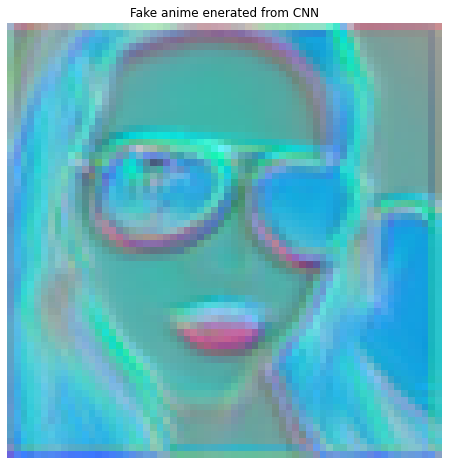

In [ ]:
# evaluate CNN baseline
with torch.no_grad():

      # get 100 real animes (from testing animes) and 100 fake anime from testing selfies and netG_s
      activation_real_a = activation_a # same as baseline 

      # get 100 fake animes
      fakeA = []
      for i in range(len(test_self)): 
          real_selfie, labels = test_self[i]
          batch_real_selfie = real_selfie.unsqueeze(0)
          fake_anime = cnn(batch_real_selfie).detach().cpu()[0]
          image = preprocess(fake_anime) # for inceptionV3
          fakeA.append(image.unsqueeze(0))  
      res = torch.Tensor(len(fakeA), 3, 299, 299)
      fakeA = torch.cat(fakeA, out=res)[:100]

      # get activation for fake animes 
      model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
      model.avgpool.register_forward_hook(get_activation("avgpool"))
      with torch.no_grad():
        out = model(fakeA)
      activation_fake_a = activation['avgpool'].flatten(start_dim=1) # (100,2048)

      # final performance metric 
      print("FID score for CNN: ", calculate_fid(activation_a.numpy(), activation_fake_a.numpy())) # 117.87860377790471

      # print some images
      fig = plt.figure(figsize=(8,8))
      plt.axis("off")
      plt.imshow(np.transpose(vutils.make_grid(fake_anime, padding=2, normalize=True),(1,2,0)), animated=True)
      plt.title("Fake anime enerated from CNN")
      plt.show()

      

# Train def 

We use BCEloss as the adversarial loss, and L1Loss as the cycle-consistency loss. 
For D_a, the discriminator for anime, the loss comes from whether it labels true animes correctly, and whether it could recognize fake animes.
Similar for D_s, the discriminator for selfies.

For the generators, the goal is to minimize the adversarial loss (loss1 from D_s) and (loss2 from D_a) AND cycle consistency loss for G_s (loss3) and G_a (loss4).
For G_s, the generator that translates selfie into anime, the loss comes from the generated animes being classified as fake anime (by D_a), and the distance between (G_a(G_s(anime))) and anime, and the distance between (G_s(G_a(selfie))) and selfie.

In [ ]:
# define the training function 

def train(loader_train_self, loader_test_self, loader_train_anime, loader_test_anime, netD_s, netD_a, netG_s, netG_a, optimizer_da, optimizer_ds, optimizer_ga, optimizer_gs, epochs=30):
    netD_s = netD_s.cuda() # classify real vs. fake selfie
    netG_s = netG_s.cuda() # real selfie -> fake anime
    netD_a = netD_a.cuda() # classify real vs. fake anime
    netG_a = netG_a.cuda() # real anime -> fake selfie

    criterionGan = nn.BCELoss() # adversarial loss
    criterionCycle = nn.L1Loss() # cycle-consistency loss

    # recording loss along epochs
    da_loss_eps = [] 
    ds_loss_eps = []
    ga_loss_eps = []
    gs_loss_eps = []
    
    for e in range(epochs):

        # for plotting 
        da_loss_ep = 0
        ds_loss_ep = 0
        ga_loss_ep = 0
        gs_loss_ep = 0
        
        for i, anime in enumerate(loader_train_anime):

          selfie = next(iter(loader_train_self))
          selfie_device = selfie[0].to(device)
          
          #### For D: 
          optimizer_da.zero_grad()
          optimizer_ds.zero_grad()
          
          real_anime = anime[0].to(device)
          b_size = real_anime.size(0)

          # For D_a
          # whether D_a recognizes real animes: "E[(D(y) − 1)^2]" term 
          output = netD_a(real_anime).view(-1) # result of classification 
          label = torch.ones_like(output) # true lables: 1 for real
          lossD_real = criterionGan(output, label) 
          # whether D_a recognizes fake animes: "E[D(G(x))^2]" term 
          fake_a = netG_s(selfie_device)
          output = netD_a(fake_a.detach()).view(-1)
          label = torch.zeros_like(output)
          lossD_fake = criterionGan(output, label)

          loss_da = lossD_real + lossD_fake
          da_loss_ep += loss_da.item()
          loss_da.backward(retain_graph=True)
          optimizer_da.step()

          # For D_s
          # whether D_s recognizes real selfies
          output = netD_s(selfie_device).view(-1) 
          label = torch.ones_like(output) # ? added
          lossD_r = criterionGan(output, label) #
          # whether D_s recognizes fake selfies 
          fake_s = netG_a(real_anime) 
          output = netD_s(fake_s.detach()).view(-1)
          label = torch.zeros_like(output)
          lossD_f = criterionGan(output, label)

          loss_ds = lossD_r + lossD_f
          ds_loss_ep += loss_ds.item()
          loss_ds.backward(retain_graph=True)
          optimizer_ds.step() 

          #### For G: minimizing adversarial loss for D_s (loss1) and D_a (loss2) 
          #### AND cycle consistency loss for G_s (loss3) and G_a (loss4)

          optimizer_ga.zero_grad()
          optimizer_gs.zero_grad()

          # G_a: wants to classify fake selfies real (1)
          output = netD_s(fake_s).view(-1)
          label = torch.ones_like(output) 
          loss1 = criterionGan(output, label) # adversarial loss for D_s

          # G_s: wants to classify fake animes real (1)
          output = netD_a(fake_a).view(-1)
          label = torch.ones_like(output)
          loss2 = criterionGan(output, label) # adversarial loss for D_a

          # Cycle-consistency loss
            # loss caused by the difference between real selfie and G_a(G_s(real selfie))
          gg_selfie = netG_a(fake_a).view(-1)
          sel = selfie_device.view(-1)
          loss3 = criterionCycle(gg_selfie, sel) * lambda_a
          
            # loss caused by the difference between real anime and G_s(G_a(real anime))
          gg_anime = netG_s(fake_s).view(-1)
          ani = real_anime.view(-1)
          loss4 = criterionCycle(gg_anime, ani) * lambda_s

          # For G_s: loss234
          loss_gs = loss2 + loss3 + loss4
          loss_gs.backward(retain_graph=True)
          gs_loss_ep += loss_gs.item()
          optimizer_gs.step()

          # For G_a: loss134
          loss_ga = loss1 + loss3 + loss4
          loss1.backward() # loss3 and loss4 have been backwarded
          ga_loss_ep += loss_ga.item()
          optimizer_ga.step()

          # print('Epoch %d, Iteration %d, discriminator loss = %.4f, generator loss = %.4f' % (e+1, i, loss_da.item()+loss_ds.item(), loss_ga.item()+loss_gs.item()))
          if i%10 == 0:
            print('Epoch %d, Iteration %d, discriminator loss = %.4f, generator loss = %.4f' % (e+1, i, loss_da.item()+loss_ds.item(), loss_ga.item()+loss_gs.item()))
            with torch.no_grad():
                  fa = fake_a.detach().cpu()
                  sd = selfie_device.detach().cpu()
            if i%100 == 0:
            
              fig = plt.figure(figsize=(8,8))
              plt.axis("off")
              plt.imshow(np.transpose(vutils.make_grid(fa, padding=2, normalize=True),(1,2,0)), animated=True)
              plt.show()
              fig = plt.figure(figsize=(8,8))
              plt.axis("off")
              plt.imshow(np.transpose(vutils.make_grid(sd, padding=2, normalize=True),(1,2,0)), animated=True)
              plt.show()
              
              # get a batch of preprocessed fake animes
              fakeA = []
              for img in fa:
                img = preprocess(img)
                fakeA.append(img.unsqueeze(0))
              res = torch.Tensor(len(fakeA), 3, 299, 299)
              fakeA = torch.cat(fakeA, out=res)

        # get the last batch of real animes from the epoch 
        realA = []
        for img in real_anime.detach().cpu():
          img = preprocess(img)
          realA.append(img.unsqueeze(0))
        res = torch.Tensor(len(realA), 3, 299, 299)
        realA = torch.cat(realA, out=res)
    
        # keeping track of D & G losses and fid per epoch 
        da_loss_eps.append(da_loss_ep)
        ds_loss_eps.append(ds_loss_ep)
        ga_loss_eps.append(ga_loss_ep)
        gs_loss_eps.append(gs_loss_ep)

    return da_loss_eps, ds_loss_eps, ga_loss_eps, gs_loss_eps

          

# Test def


In [ ]:
# defining test 

def test(a_test_loader, s_test_loader, netG_s):
    # netG_s = netG_s.cuda() # real selfie -> fake anime
    # netG_a.eval() # set model to evaluation mode
    
    ep = len(test_anime) // batch_size # num of batches 
    total_fid = 0 # for fid 
    with torch.no_grad():

      # get 100 real animes (from testing animes) and 100 fake anime from testing selfies and netG_s
      activation_real_a = activation_a # same as baseline 

      # get 100 fake animes
      fakeA = []
      for i in range(len(test_self)): 
          real_selfie, labels = test_self[i]
          fake_anime = netG_s(real_selfie.to(device).unsqueeze(0)).detach().cpu()[0]
          image = preprocess(fake_anime) # for inceptionV3
          fakeA.append(image.unsqueeze(0))  
      res = torch.Tensor(len(fakeA), 3, 299, 299)
      fakeA = torch.cat(fakeA, out=res)[:100]

      # get activation for fake animes 
      model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
      model.avgpool.register_forward_hook(get_activation("avgpool"))
      with torch.no_grad():
        out = model(fakeA)
      activation_fake_a = activation['avgpool'].flatten(start_dim=1) # (100,2048)

      # final performance metric 
      print("FID score: ", calculate_fid(activation_a.numpy(), activation_fake_a.numpy()))

      # print some images
      for i in range(ep):
        real_selfie_batch = next(iter(s_test_loader))[0] # (batch_size,3,64,64)
        real_anime_batch = next(iter(a_test_loader))[0] # (batch_size,3,64,64)
        selfie_batch_device = real_selfie_batch.to(device) # real selfies 
        fake_anime_batch= netG_s(selfie_batch_device).detach().cpu() 
        ff_selfies_batch = netG_a(netG_s(selfie_batch_device)).detach().cpu() # fake selfies from fake animes  
      
        print('Here are some selfies')
        fig = plt.figure(figsize=(8,8))
        plt.axis("off")
        plt.imshow(np.transpose(vutils.make_grid(selfie_batch_device.detach().cpu(), padding=2, normalize=True),(1,2,0)), animated=True)
        plt.title("real selfies")
        plt.show()

        print('Here are some fake anime from selfies')
        fig = plt.figure(figsize=(8,8))
        plt.axis("off")
        plt.title("fake animes")
        plt.imshow(np.transpose(vutils.make_grid(fake_anime_batch, padding=2, normalize=True),(1,2,0)), animated=True)

        print("Here are some fake selfies from fake animes")
        fig = plt.figure(figsize=(8,8))
        plt.axis("off")
        plt.title("fake-fake selfies")
        plt.imshow(np.transpose(vutils.make_grid(ff_selfies_batch, padding=2, normalize=True),(1,2,0)), animated=True)

        plt.show()

      

# GenResNet

The network structure for Generators is ResNet. It contains 6 blocks of (Conv,BatchNorm, ReLU, Conv, BatchNorm).

In [ ]:
# Generator using resnet 

class GenResNet(nn.Module):
    def __init__(self):
        super(GenResNet, self).__init__()
        self.start = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1),
            nn.Conv2d(64, 128, 3, padding=1),
        )

        self.block1 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block2 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block3 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block4 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block5 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block6 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.end = nn.Sequential(
            nn.Conv2d(128, 64, 3, padding=1),
            nn.Conv2d(64, 3, 3, padding=1),
        )

    def forward(self, input):
      x = self.start(input)
      y = self.block1(x)
      z = x + y
      y = self.block2(z)
      z = z + y
      y = self.block3(z)
      z = z + y
      y = self.block4(z)
      z = z + y
      y = self.block5(z)
      z = z + y
      y = self.block6(z)
      z = z + y
      y = self.end(z)
      return y

In [ ]:
class GenResNet2(nn.Module):
    def __init__(self):
        super(GenResNet2, self).__init__()
        self.start = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1),
            nn.Conv2d(64, 128, 3, padding=1),
        )

        self.block1 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block2 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block3 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block4 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block5 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.block6 = nn.Sequential(
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
        )
        self.end = nn.Sequential(
            nn.Conv2d(128, 64, 3, padding=1),
            nn.Conv2d(64, 3, 3, padding=1),
        )

    def forward(self, input):
      x = self.start(input)
      y = self.block1(x)
      z = x + y
      y = self.block2(z)
      z = z + y
      y = self.block3(z)
      z = z + y
      y = self.block4(z)
      z = z + y
      y = self.block5(z)
      z = z + y
      y = self.block6(z)
      z = z + y
      y = self.end(z)
      return y

# GenUnet


We also tried UNet structure for the generators. It is a U-shaped network that downsamples the input image from 64 by 64 to 4 by 4, and then upsample it while concatenating it with images from previous layers.

In [ ]:
# Generators with Unet

class GenUnet1(torch.nn.Module):
  def __init__(self):
    super(GenUnet1,self).__init__()
    # conv
    # downward
    self.conv1 = torch.nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv2 = torch.nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv3 = torch.nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv4 = torch.nn.Conv2d(in_channels = 128, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv5 = torch.nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv6 = torch.nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv7 = torch.nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv8 = torch.nn.Conv2d(in_channels = 512, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv9 = torch.nn.Conv2d(in_channels = 512, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)
    self.conv10 = torch.nn.Conv2d(in_channels = 1024, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)

    # upward
    self.conv11up = torch.nn.ConvTranspose2d(in_channels = 1024, out_channels = 512, kernel_size = 2, stride = 2) # up 
    # self.conv11 = torch.nn.Conv2d(in_channels = 1024, out_channels = 512, kernel_size = 2, stride = 2) # to right

    self.conv12 = torch.nn.Conv2d(in_channels = 1024, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv13up = torch.nn.ConvTranspose2d(in_channels = 512, out_channels = 256, kernel_size = 2, stride = 2)
    # self.conv13 = torch.nn.Conv2d(in_channels = 512, out_channels = 256, kernel_size = 2, stride = 2)
    
    self.conv14 = torch.nn.Conv2d(in_channels = 512, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv15up = torch.nn.ConvTranspose2d(in_channels = 256, out_channels = 128, kernel_size = 2, stride = 2)
    # self.conv15 = torch.nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 2, stride = 2)
    
    self.conv16 = torch.nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv17up = torch.nn.ConvTranspose2d(in_channels = 128, out_channels = 64, kernel_size = 2, stride = 2)
    # self.conv17 = torch.nn.Conv2d(in_channels = 128, out_channels = 64, kernel_size = 2, stride = 2)
   
    
    self.conv18 = torch.nn.Conv2d(in_channels = 128, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv19 = torch.nn.Conv2d(in_channels = 64, out_channels = 3, kernel_size = 3, stride = 1, padding = 1) # ?? 1x1 kernel? dense? 

    self.conv1up = torch.nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv2up = torch.nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv3up = torch.nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv4up = torch.nn.Conv2d(in_channels = 128, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv5up = torch.nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv6up = torch.nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv7up = torch.nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv8up = torch.nn.Conv2d(in_channels = 512, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv9up = torch.nn.Conv2d(in_channels = 512, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)


    # relu
    self.relu = torch.nn.ReLU()

    # maxpooling
    self.maxpool = torch.nn.MaxPool2d(kernel_size = 2, stride = 2)

  def forward(self,x):
    # downward
    x = self.relu(self.conv1(x)) # 3 -> 64
    x1 = self.relu(self.conv2(x)) # 64->64
    # print("64: ", x1.size())

    x = self.maxpool(x1)

    x = self.relu(self.conv3(x)) # 64 -> 128
    x2 = self.relu(self.conv4(x)) # 128 -> 128
    # print("128: ", x2.size())

    x = self.maxpool(x2)
  
    x = self.relu(self.conv5(x)) # 128 -> 256
    x3 = self.relu(self.conv6(x)) # 256 -> 256
    # print("256: ", x3.size())

    x = self.maxpool(x3) 

    x = self.relu(self.conv7(x)) #256 -> 512 
    x4 = self.relu(self.conv8(x)) # 512 -> 512
    # print("512: ", x4.size())

    x = self.maxpool(x4) 
    
    x = self.relu(self.conv9(x)) # 512 -> 1024
    x5 = self.relu(self.conv10(x)) # 1024 -> 1024
    # print("1024: ", x5.size())

    # upward
    x = self.conv11up(x5) # 1024->512 (upconv 2x2)
    # print("unet 1cating x and x4: ", x.size(), x4.size()) # torch.Size([8, 512, 8, 8]) torch.Size([8, 512, 8, 8])
    x = torch.cat((x,x4), dim = 1) # 512->1024
    # print(x.size()) #torch.Size([8, 1024, 8, 8])
    x = self.relu(self.conv12(x)) # 1024->512
    # print(x.size()) # torch.Size([8, 512, 16, 16])
    x = self.relu(self.conv8up(x)) # 512->512
    # print(x.size()) #torch.Size([8, 512, 16, 16])

    x = self.conv13up(x) # 512 -> 256 upconv
   #  print("unet1 cating x and x3: ", x.size(), x3.size()) # torch.Size([8, 256, 16, 16]) torch.Size([8, 256, 16, 16])
    x = torch.cat((x, x3), dim = 1) # 256->512
    x = self.relu(self.conv14(x)) # 512->256
    x = self.relu(self.conv6up(x)) # 256->256

    x = self.conv15up(x) # 256->128 upconv
    #print("unet1 cating x and x2: ", x.size(), x2.size()) # 
    x = torch.cat((x,x2), dim = 1) # 128->256
    x = self.relu(self.conv16(x)) # 256->128
    x = self.relu(self.conv4up(x)) # 128->128

    x = self.conv17up(x) # 128->64 upconv
    x = torch.cat((x,x1), dim = 1) # 64->128
    x = self.relu(self.conv18(x)) # 128->64
    x = self.relu(self.conv2up(x)) # 64->64

    x = self.conv19(x)

    return x


In [ ]:
class GenUnet2(torch.nn.Module):
  def __init__(self):
    super(GenUnet2,self).__init__()
    # conv
    # downward
    self.conv1 = torch.nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv2 = torch.nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv3 = torch.nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv4 = torch.nn.Conv2d(in_channels = 128, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv5 = torch.nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv6 = torch.nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv7 = torch.nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv8 = torch.nn.Conv2d(in_channels = 512, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv9 = torch.nn.Conv2d(in_channels = 512, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)
    self.conv10 = torch.nn.Conv2d(in_channels = 1024, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)

    # upward
    self.conv11up = torch.nn.ConvTranspose2d(in_channels = 1024, out_channels = 512, kernel_size = 2, stride = 2) # up 
    # self.conv11 = torch.nn.Conv2d(in_channels = 1024, out_channels = 512, kernel_size = 2, stride = 2) # to right

    self.conv12 = torch.nn.Conv2d(in_channels = 1024, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv13up = torch.nn.ConvTranspose2d(in_channels = 512, out_channels = 256, kernel_size = 2, stride = 2)
    # self.conv13 = torch.nn.Conv2d(in_channels = 512, out_channels = 256, kernel_size = 2, stride = 2)
    
    self.conv14 = torch.nn.Conv2d(in_channels = 512, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv15up = torch.nn.ConvTranspose2d(in_channels = 256, out_channels = 128, kernel_size = 2, stride = 2)
    # self.conv15 = torch.nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 2, stride = 2)
    
    self.conv16 = torch.nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    
    self.conv17up = torch.nn.ConvTranspose2d(in_channels = 128, out_channels = 64, kernel_size = 2, stride = 2)
    # self.conv17 = torch.nn.Conv2d(in_channels = 128, out_channels = 64, kernel_size = 2, stride = 2)
   
    
    self.conv18 = torch.nn.Conv2d(in_channels = 128, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv19 = torch.nn.Conv2d(in_channels = 64, out_channels = 3, kernel_size = 3, stride = 1, padding = 1) # ?? 1x1 kernel? dense? 

    self.conv1up = torch.nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv2up = torch.nn.Conv2d(in_channels = 64, out_channels = 64, kernel_size = 3, stride = 1, padding = 1)
    self.conv3up = torch.nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv4up = torch.nn.Conv2d(in_channels = 128, out_channels = 128, kernel_size = 3, stride = 1, padding = 1)
    self.conv5up = torch.nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv6up = torch.nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, stride = 1, padding = 1)
    self.conv7up = torch.nn.Conv2d(in_channels = 256, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv8up = torch.nn.Conv2d(in_channels = 512, out_channels = 512, kernel_size = 3, stride = 1, padding = 1)
    self.conv9up = torch.nn.Conv2d(in_channels = 512, out_channels = 1024, kernel_size = 3, stride = 1, padding = 1)


    # relu
    self.relu = torch.nn.ReLU()

    # maxpooling
    self.maxpool = torch.nn.MaxPool2d(kernel_size = 2, stride = 2)

  def forward(self,x):
    # downward
    x = self.relu(self.conv1(x)) # 3 -> 64
    x1 = self.relu(self.conv2(x)) # 64->64
    # print("64: ", x1.size())

    x = self.maxpool(x1)

    x = self.relu(self.conv3(x)) # 64 -> 128
    x2 = self.relu(self.conv4(x)) # 128 -> 128
    # print("128: ", x2.size())

    x = self.maxpool(x2)
  
    x = self.relu(self.conv5(x)) # 128 -> 256
    x3 = self.relu(self.conv6(x)) # 256 -> 256
    # print("256: ", x3.size())

    x = self.maxpool(x3) 

    x = self.relu(self.conv7(x)) #256 -> 512 
    x4 = self.relu(self.conv8(x)) # 512 -> 512
    # print("512: ", x4.size())

    x = self.maxpool(x4) 
    
    x = self.relu(self.conv9(x)) # 512 -> 1024
    x5 = self.relu(self.conv10(x)) # 1024 -> 1024
    # print("1024: ", x5.size())

    # upward
    x = self.conv11up(x5) # 1024->512 (upconv 2x2)
    # print("unet 1cating x and x4: ", x.size(), x4.size()) # torch.Size([8, 512, 8, 8]) torch.Size([8, 512, 8, 8])
    x = torch.cat((x,x4), dim = 1) # 512->1024
    # print(x.size()) #torch.Size([8, 1024, 8, 8])
    x = self.relu(self.conv12(x)) # 1024->512
    # print(x.size()) # torch.Size([8, 512, 16, 16])
    x = self.relu(self.conv8up(x)) # 512->512
    # print(x.size()) #torch.Size([8, 512, 16, 16])

    x = self.conv13up(x) # 512 -> 256 upconv
   #  print("unet1 cating x and x3: ", x.size(), x3.size()) # torch.Size([8, 256, 16, 16]) torch.Size([8, 256, 16, 16])
    x = torch.cat((x, x3), dim = 1) # 256->512
    x = self.relu(self.conv14(x)) # 512->256
    x = self.relu(self.conv6up(x)) # 256->256

    x = self.conv15up(x) # 256->128 upconv
    #print("unet1 cating x and x2: ", x.size(), x2.size()) # 
    x = torch.cat((x,x2), dim = 1) # 128->256
    x = self.relu(self.conv16(x)) # 256->128
    x = self.relu(self.conv4up(x)) # 128->128

    x = self.conv17up(x) # 128->64 upconv
    x = torch.cat((x,x1), dim = 1) # 64->128
    x = self.relu(self.conv18(x)) # 128->64
    x = self.relu(self.conv2up(x)) # 64->64

    x = self.conv19(x)

    return x


# Descriminators

In [ ]:
# Discriminators 

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(

            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(128),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(256),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(512),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
class Discriminator2(nn.Module):
    def __init__(self):
        super(Discriminator2, self).__init__()
        self.main = nn.Sequential(

            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(128),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(256),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False),
            nn.BatchNorm2d(512),
            #nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(True),

            nn.Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Training


In [ ]:
# clean up the cache (to avoid out-of-memory issues)
import gc
gc.collect()
torch.cuda.empty_cache()
torch.cuda.memory_summary(device=None, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |       0 B  |    1190 KB |    2383 KB |    2383 KB |\n|       from large pool |       0 B  |       0 KB |       0 KB |       0 KB |\n|       from small pool |       0 B  |    1190 KB |    2383 KB |    2383 KB |\n|---------------------------------------------------------------------------|\n| Active memory         |       0 B  |    1190 KB |    2383 KB |    2383 KB |\n|       from large pool |       0 B  |       0 KB |

Epoch 1, Iteration 0, discriminator loss = 2.7702, generator loss = 178.6269


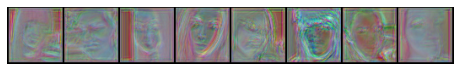

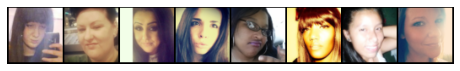

Epoch 1, Iteration 10, discriminator loss = 0.6651, generator loss = 127.3389
Epoch 1, Iteration 20, discriminator loss = 0.1880, generator loss = 80.6608
Epoch 1, Iteration 30, discriminator loss = 0.5185, generator loss = 76.9456
Epoch 1, Iteration 40, discriminator loss = 0.1386, generator loss = 64.4380
Epoch 1, Iteration 50, discriminator loss = 0.4743, generator loss = 72.1145
Epoch 1, Iteration 60, discriminator loss = 0.5664, generator loss = 66.8126
Epoch 1, Iteration 70, discriminator loss = 0.0975, generator loss = 55.2385
Epoch 1, Iteration 80, discriminator loss = 0.2606, generator loss = 54.0837
Epoch 1, Iteration 90, discriminator loss = 0.2581, generator loss = 70.7348
Epoch 1, Iteration 100, discriminator loss = 0.1504, generator loss = 60.2014


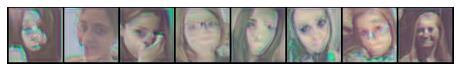

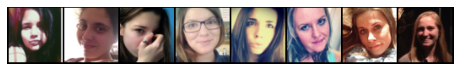

Epoch 1, Iteration 110, discriminator loss = 0.7273, generator loss = 59.3783
Epoch 1, Iteration 120, discriminator loss = 0.9492, generator loss = 55.7691
Epoch 1, Iteration 130, discriminator loss = 1.6577, generator loss = 66.4557
Epoch 1, Iteration 140, discriminator loss = 0.4327, generator loss = 52.9726
Epoch 1, Iteration 150, discriminator loss = 0.7361, generator loss = 60.8173
Epoch 1, Iteration 160, discriminator loss = 1.3711, generator loss = 59.6873
Epoch 1, Iteration 170, discriminator loss = 0.2554, generator loss = 48.4475
Epoch 1, Iteration 180, discriminator loss = 0.2126, generator loss = 52.7937
Epoch 1, Iteration 190, discriminator loss = 1.9813, generator loss = 47.8165
Epoch 1, Iteration 200, discriminator loss = 0.5537, generator loss = 47.9898


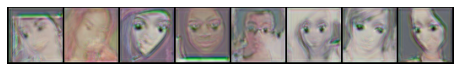

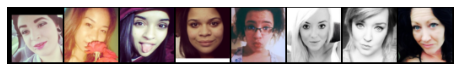

Epoch 1, Iteration 210, discriminator loss = 1.6119, generator loss = 53.7176
Epoch 1, Iteration 220, discriminator loss = 0.6577, generator loss = 51.0833
Epoch 1, Iteration 230, discriminator loss = 0.5337, generator loss = 49.5765
Epoch 1, Iteration 240, discriminator loss = 1.8614, generator loss = 51.5153
Epoch 1, Iteration 250, discriminator loss = 0.2905, generator loss = 46.8250
Epoch 1, Iteration 260, discriminator loss = 0.2450, generator loss = 59.1435
Epoch 1, Iteration 270, discriminator loss = 0.4189, generator loss = 48.5587
Epoch 1, Iteration 280, discriminator loss = 0.1287, generator loss = 50.9218
Epoch 1, Iteration 290, discriminator loss = 0.0946, generator loss = 52.2142
Epoch 1, Iteration 300, discriminator loss = 0.9059, generator loss = 48.0481


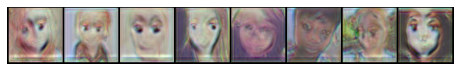

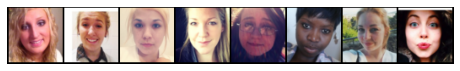

Epoch 1, Iteration 310, discriminator loss = 0.4758, generator loss = 44.7193
Epoch 1, Iteration 320, discriminator loss = 0.5418, generator loss = 55.3970
Epoch 1, Iteration 330, discriminator loss = 0.3528, generator loss = 42.7616
Epoch 1, Iteration 340, discriminator loss = 0.7998, generator loss = 49.5538
Epoch 1, Iteration 350, discriminator loss = 1.0647, generator loss = 48.7460
Epoch 1, Iteration 360, discriminator loss = 0.1024, generator loss = 57.7300
Epoch 1, Iteration 370, discriminator loss = 0.3817, generator loss = 54.1049
Epoch 1, Iteration 380, discriminator loss = 0.2777, generator loss = 57.9823
Epoch 1, Iteration 390, discriminator loss = 1.0956, generator loss = 55.0143
Epoch 1, Iteration 400, discriminator loss = 0.2064, generator loss = 54.6993


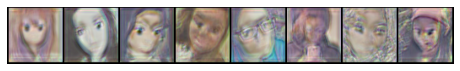

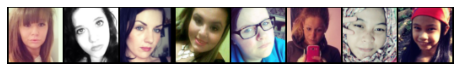

Epoch 1, Iteration 410, discriminator loss = 0.5567, generator loss = 48.7389
Epoch 1, Iteration 420, discriminator loss = 0.6026, generator loss = 50.0429
Epoch 2, Iteration 0, discriminator loss = 2.9469, generator loss = 50.8868


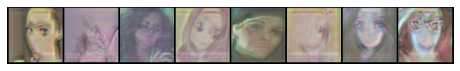

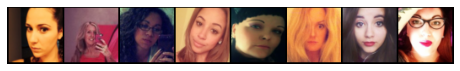

Epoch 2, Iteration 10, discriminator loss = 0.3858, generator loss = 42.1764
Epoch 2, Iteration 20, discriminator loss = 0.1070, generator loss = 53.9580
Epoch 2, Iteration 30, discriminator loss = 0.0828, generator loss = 46.9797
Epoch 2, Iteration 40, discriminator loss = 0.0428, generator loss = 59.4645
Epoch 2, Iteration 50, discriminator loss = 0.1855, generator loss = 57.4356
Epoch 2, Iteration 60, discriminator loss = 0.2818, generator loss = 46.5278
Epoch 2, Iteration 70, discriminator loss = 0.2340, generator loss = 45.8587
Epoch 2, Iteration 80, discriminator loss = 0.3175, generator loss = 48.2020
Epoch 2, Iteration 90, discriminator loss = 0.3397, generator loss = 65.4729
Epoch 2, Iteration 100, discriminator loss = 0.2815, generator loss = 63.7979


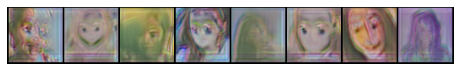

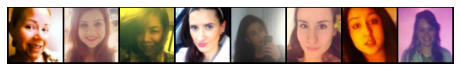

Epoch 2, Iteration 110, discriminator loss = 0.2066, generator loss = 69.8262
Epoch 2, Iteration 120, discriminator loss = 0.6991, generator loss = 50.9434
Epoch 2, Iteration 130, discriminator loss = 0.9838, generator loss = 50.8066
Epoch 2, Iteration 140, discriminator loss = 0.1222, generator loss = 51.9650
Epoch 2, Iteration 150, discriminator loss = 0.0863, generator loss = 51.2551
Epoch 2, Iteration 160, discriminator loss = 0.6094, generator loss = 58.6359
Epoch 2, Iteration 170, discriminator loss = 0.7792, generator loss = 62.1899
Epoch 2, Iteration 180, discriminator loss = 0.2815, generator loss = 61.9450
Epoch 2, Iteration 190, discriminator loss = 0.2721, generator loss = 57.3994
Epoch 2, Iteration 200, discriminator loss = 0.1107, generator loss = 46.9810


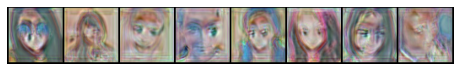

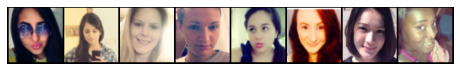

Epoch 2, Iteration 210, discriminator loss = 0.0706, generator loss = 48.5451
Epoch 2, Iteration 220, discriminator loss = 0.3941, generator loss = 61.0021
Epoch 2, Iteration 230, discriminator loss = 0.0497, generator loss = 52.0544
Epoch 2, Iteration 240, discriminator loss = 0.0711, generator loss = 54.6922
Epoch 2, Iteration 250, discriminator loss = 0.4417, generator loss = 56.1821
Epoch 2, Iteration 260, discriminator loss = 0.1790, generator loss = 49.1059
Epoch 2, Iteration 270, discriminator loss = 0.0846, generator loss = 55.2124
Epoch 2, Iteration 280, discriminator loss = 0.0370, generator loss = 47.2379
Epoch 2, Iteration 290, discriminator loss = 0.8258, generator loss = 50.0056
Epoch 2, Iteration 300, discriminator loss = 1.4261, generator loss = 59.4137


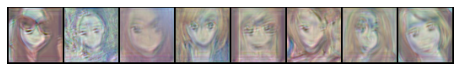

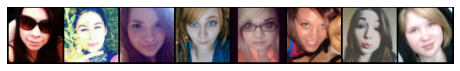

Epoch 2, Iteration 310, discriminator loss = 0.0740, generator loss = 42.8689
Epoch 2, Iteration 320, discriminator loss = 2.3027, generator loss = 55.1145
Epoch 2, Iteration 330, discriminator loss = 1.2434, generator loss = 44.0056
Epoch 2, Iteration 340, discriminator loss = 0.5834, generator loss = 49.8877
Epoch 2, Iteration 350, discriminator loss = 0.3314, generator loss = 46.5322
Epoch 2, Iteration 360, discriminator loss = 0.0940, generator loss = 49.5768
Epoch 2, Iteration 370, discriminator loss = 0.1317, generator loss = 48.7425
Epoch 2, Iteration 380, discriminator loss = 0.1586, generator loss = 44.9215
Epoch 2, Iteration 390, discriminator loss = 0.3507, generator loss = 54.5699
Epoch 2, Iteration 400, discriminator loss = 0.3050, generator loss = 53.5187


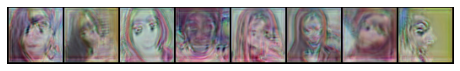

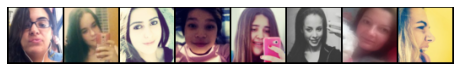

Epoch 2, Iteration 410, discriminator loss = 0.0451, generator loss = 51.2230
Epoch 2, Iteration 420, discriminator loss = 0.2982, generator loss = 66.3439
Epoch 3, Iteration 0, discriminator loss = 0.0555, generator loss = 50.0569


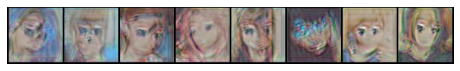

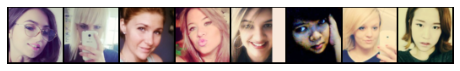

Epoch 3, Iteration 10, discriminator loss = 1.3199, generator loss = 54.6782
Epoch 3, Iteration 20, discriminator loss = 0.1022, generator loss = 52.0450
Epoch 3, Iteration 30, discriminator loss = 0.1053, generator loss = 51.2362
Epoch 3, Iteration 40, discriminator loss = 0.1382, generator loss = 57.7952
Epoch 3, Iteration 50, discriminator loss = 0.7546, generator loss = 58.6711
Epoch 3, Iteration 60, discriminator loss = 0.5303, generator loss = 49.2004
Epoch 3, Iteration 70, discriminator loss = 0.0951, generator loss = 56.8224
Epoch 3, Iteration 80, discriminator loss = 0.4033, generator loss = 47.6912
Epoch 3, Iteration 90, discriminator loss = 1.0847, generator loss = 49.1031
Epoch 3, Iteration 100, discriminator loss = 0.3534, generator loss = 50.1290


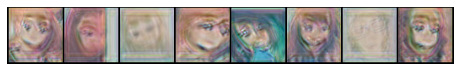

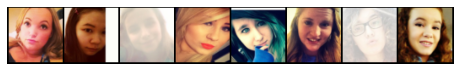

Epoch 3, Iteration 110, discriminator loss = 0.0870, generator loss = 44.5249
Epoch 3, Iteration 120, discriminator loss = 0.2032, generator loss = 41.8186
Epoch 3, Iteration 130, discriminator loss = 0.5381, generator loss = 52.4084
Epoch 3, Iteration 140, discriminator loss = 0.1199, generator loss = 44.3792
Epoch 3, Iteration 150, discriminator loss = 0.1027, generator loss = 46.5103
Epoch 3, Iteration 160, discriminator loss = 0.0484, generator loss = 45.3755
Epoch 3, Iteration 170, discriminator loss = 0.0629, generator loss = 52.3472
Epoch 3, Iteration 180, discriminator loss = 0.0158, generator loss = 53.9060
Epoch 3, Iteration 190, discriminator loss = 0.7408, generator loss = 42.4677
Epoch 3, Iteration 200, discriminator loss = 0.0691, generator loss = 49.7426


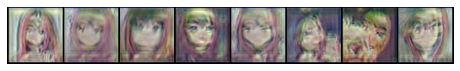

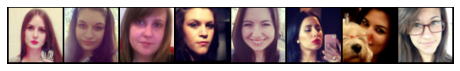

Epoch 3, Iteration 210, discriminator loss = 0.0188, generator loss = 47.7437
Epoch 3, Iteration 220, discriminator loss = 0.1076, generator loss = 47.3291
Epoch 3, Iteration 230, discriminator loss = 0.2215, generator loss = 51.1891
Epoch 3, Iteration 240, discriminator loss = 0.0486, generator loss = 57.9865
Epoch 3, Iteration 250, discriminator loss = 0.0478, generator loss = 53.9169
Epoch 3, Iteration 260, discriminator loss = 0.0387, generator loss = 43.0264
Epoch 3, Iteration 270, discriminator loss = 0.1090, generator loss = 56.4895
Epoch 3, Iteration 280, discriminator loss = 0.7651, generator loss = 53.1855
Epoch 3, Iteration 290, discriminator loss = 0.5802, generator loss = 45.7351
Epoch 3, Iteration 300, discriminator loss = 0.5910, generator loss = 43.7527


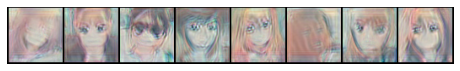

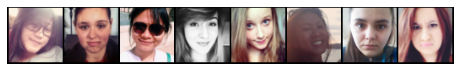

Epoch 3, Iteration 310, discriminator loss = 0.0972, generator loss = 45.2178
Epoch 3, Iteration 320, discriminator loss = 0.2619, generator loss = 47.2808
Epoch 3, Iteration 330, discriminator loss = 1.0196, generator loss = 48.0057
Epoch 3, Iteration 340, discriminator loss = 0.4049, generator loss = 50.0956
Epoch 3, Iteration 350, discriminator loss = 0.4117, generator loss = 48.2569
Epoch 3, Iteration 360, discriminator loss = 1.2272, generator loss = 46.6840
Epoch 3, Iteration 370, discriminator loss = 0.8345, generator loss = 56.4095
Epoch 3, Iteration 380, discriminator loss = 0.1758, generator loss = 45.3384
Epoch 3, Iteration 390, discriminator loss = 0.6710, generator loss = 55.2744
Epoch 3, Iteration 400, discriminator loss = 0.3378, generator loss = 37.1374


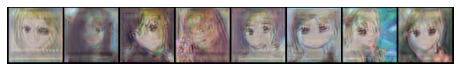

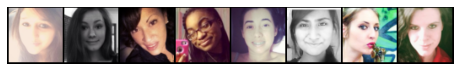

Epoch 3, Iteration 410, discriminator loss = 0.3937, generator loss = 56.9409
Epoch 3, Iteration 420, discriminator loss = 0.4129, generator loss = 46.9737
Epoch 4, Iteration 0, discriminator loss = 0.1676, generator loss = 40.0685


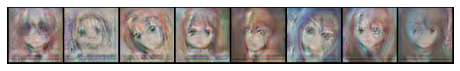

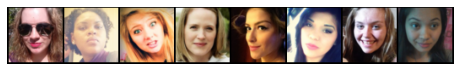

Epoch 4, Iteration 10, discriminator loss = 0.1515, generator loss = 45.4566
Epoch 4, Iteration 20, discriminator loss = 0.5688, generator loss = 43.9971
Epoch 4, Iteration 30, discriminator loss = 0.1881, generator loss = 59.8791
Epoch 4, Iteration 40, discriminator loss = 0.3226, generator loss = 46.5076
Epoch 4, Iteration 50, discriminator loss = 1.8327, generator loss = 53.0706
Epoch 4, Iteration 60, discriminator loss = 0.6248, generator loss = 41.8782
Epoch 4, Iteration 70, discriminator loss = 0.4246, generator loss = 52.0485
Epoch 4, Iteration 80, discriminator loss = 0.1681, generator loss = 49.0487
Epoch 4, Iteration 90, discriminator loss = 0.2560, generator loss = 44.6218
Epoch 4, Iteration 100, discriminator loss = 0.2092, generator loss = 49.2141


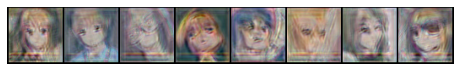

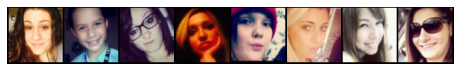

Epoch 4, Iteration 110, discriminator loss = 0.1500, generator loss = 39.4504
Epoch 4, Iteration 120, discriminator loss = 0.4412, generator loss = 41.7137
Epoch 4, Iteration 130, discriminator loss = 0.5268, generator loss = 46.8762
Epoch 4, Iteration 140, discriminator loss = 1.4049, generator loss = 50.6915
Epoch 4, Iteration 150, discriminator loss = 0.7339, generator loss = 47.9458
Epoch 4, Iteration 160, discriminator loss = 0.7597, generator loss = 46.6467
Epoch 4, Iteration 170, discriminator loss = 2.2338, generator loss = 44.6602
Epoch 4, Iteration 180, discriminator loss = 0.0747, generator loss = 48.4056
Epoch 4, Iteration 190, discriminator loss = 0.4007, generator loss = 45.5298
Epoch 4, Iteration 200, discriminator loss = 0.6767, generator loss = 47.7780


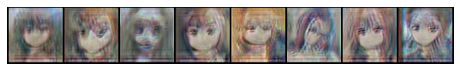

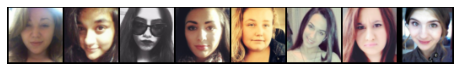

Epoch 4, Iteration 210, discriminator loss = 0.0571, generator loss = 45.9742
Epoch 4, Iteration 220, discriminator loss = 0.0593, generator loss = 50.5553
Epoch 4, Iteration 230, discriminator loss = 0.1619, generator loss = 48.6468
Epoch 4, Iteration 240, discriminator loss = 0.8722, generator loss = 43.3431
Epoch 4, Iteration 250, discriminator loss = 0.5551, generator loss = 50.1482
Epoch 4, Iteration 260, discriminator loss = 0.0514, generator loss = 47.0155
Epoch 4, Iteration 270, discriminator loss = 0.0918, generator loss = 45.9953
Epoch 4, Iteration 280, discriminator loss = 0.2225, generator loss = 53.0565
Epoch 4, Iteration 290, discriminator loss = 0.4741, generator loss = 43.5960
Epoch 4, Iteration 300, discriminator loss = 0.0688, generator loss = 49.0549


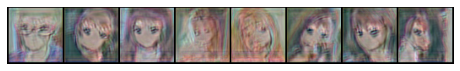

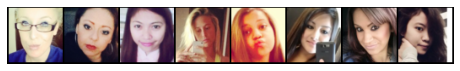

Epoch 4, Iteration 310, discriminator loss = 0.1385, generator loss = 49.5286
Epoch 4, Iteration 320, discriminator loss = 0.9657, generator loss = 51.5694
Epoch 4, Iteration 330, discriminator loss = 0.2113, generator loss = 54.9302
Epoch 4, Iteration 340, discriminator loss = 0.1017, generator loss = 48.8632
Epoch 4, Iteration 350, discriminator loss = 0.5236, generator loss = 43.3545
Epoch 4, Iteration 360, discriminator loss = 0.1725, generator loss = 48.8854
Epoch 4, Iteration 370, discriminator loss = 0.0463, generator loss = 43.8753
Epoch 4, Iteration 380, discriminator loss = 0.6680, generator loss = 51.2245
Epoch 4, Iteration 390, discriminator loss = 2.0889, generator loss = 48.1910
Epoch 4, Iteration 400, discriminator loss = 0.0497, generator loss = 51.0068


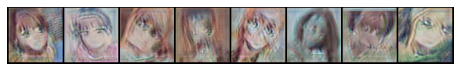

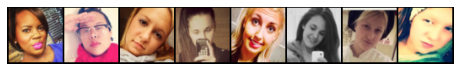

Epoch 4, Iteration 410, discriminator loss = 0.1597, generator loss = 39.0198
Epoch 4, Iteration 420, discriminator loss = 0.4350, generator loss = 50.3398
Epoch 5, Iteration 0, discriminator loss = 0.1083, generator loss = 48.7218


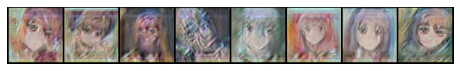

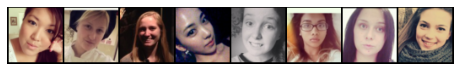

Epoch 5, Iteration 10, discriminator loss = 0.1466, generator loss = 52.3130
Epoch 5, Iteration 20, discriminator loss = 0.3362, generator loss = 44.8390
Epoch 5, Iteration 30, discriminator loss = 0.3419, generator loss = 48.7909
Epoch 5, Iteration 40, discriminator loss = 0.1922, generator loss = 41.0885
Epoch 5, Iteration 50, discriminator loss = 0.3034, generator loss = 39.4174
Epoch 5, Iteration 60, discriminator loss = 0.1862, generator loss = 48.1229
Epoch 5, Iteration 70, discriminator loss = 0.2464, generator loss = 47.5633
Epoch 5, Iteration 80, discriminator loss = 0.3353, generator loss = 46.2890
Epoch 5, Iteration 90, discriminator loss = 0.3328, generator loss = 48.0604
Epoch 5, Iteration 100, discriminator loss = 0.5701, generator loss = 44.9408


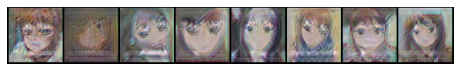

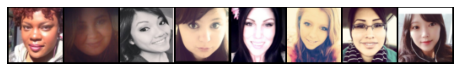

Epoch 5, Iteration 110, discriminator loss = 0.2730, generator loss = 44.6347
Epoch 5, Iteration 120, discriminator loss = 0.1400, generator loss = 52.1116
Epoch 5, Iteration 130, discriminator loss = 0.2555, generator loss = 41.8169
Epoch 5, Iteration 140, discriminator loss = 0.0649, generator loss = 49.8752
Epoch 5, Iteration 150, discriminator loss = 0.1541, generator loss = 44.6441
Epoch 5, Iteration 160, discriminator loss = 0.3582, generator loss = 44.0118
Epoch 5, Iteration 170, discriminator loss = 0.4528, generator loss = 44.3489
Epoch 5, Iteration 180, discriminator loss = 0.2063, generator loss = 47.5263
Epoch 5, Iteration 190, discriminator loss = 0.3173, generator loss = 50.1187
Epoch 5, Iteration 200, discriminator loss = 0.0769, generator loss = 45.8465


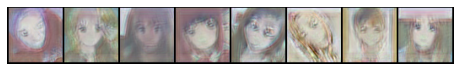

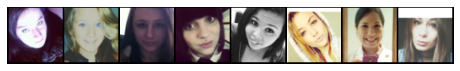

Epoch 5, Iteration 210, discriminator loss = 0.2034, generator loss = 42.2295
Epoch 5, Iteration 220, discriminator loss = 0.3434, generator loss = 39.1524
Epoch 5, Iteration 230, discriminator loss = 0.1134, generator loss = 39.0055
Epoch 5, Iteration 240, discriminator loss = 0.3706, generator loss = 48.7200
Epoch 5, Iteration 250, discriminator loss = 0.3869, generator loss = 45.8522
Epoch 5, Iteration 260, discriminator loss = 0.0517, generator loss = 51.5823
Epoch 5, Iteration 270, discriminator loss = 0.1804, generator loss = 43.6620
Epoch 5, Iteration 280, discriminator loss = 0.2185, generator loss = 46.7294
Epoch 5, Iteration 290, discriminator loss = 0.4789, generator loss = 49.8481
Epoch 5, Iteration 300, discriminator loss = 0.6687, generator loss = 52.1305


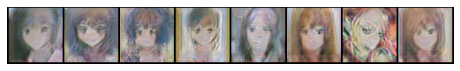

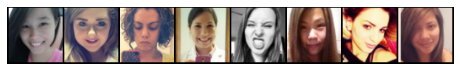

Epoch 5, Iteration 310, discriminator loss = 0.1931, generator loss = 41.1351
Epoch 5, Iteration 320, discriminator loss = 0.2481, generator loss = 49.5973
Epoch 5, Iteration 330, discriminator loss = 0.3175, generator loss = 47.8458
Epoch 5, Iteration 340, discriminator loss = 0.0941, generator loss = 48.0913
Epoch 5, Iteration 350, discriminator loss = 0.1675, generator loss = 41.6495
Epoch 5, Iteration 360, discriminator loss = 0.3001, generator loss = 43.4321
Epoch 5, Iteration 370, discriminator loss = 0.1059, generator loss = 44.0742
Epoch 5, Iteration 380, discriminator loss = 0.1833, generator loss = 44.8335
Epoch 5, Iteration 390, discriminator loss = 0.0681, generator loss = 45.2717
Epoch 5, Iteration 400, discriminator loss = 1.1166, generator loss = 52.6494


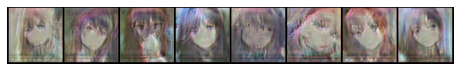

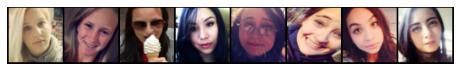

Epoch 5, Iteration 410, discriminator loss = 0.0545, generator loss = 47.8661
Epoch 5, Iteration 420, discriminator loss = 0.6744, generator loss = 46.0770
Epoch 6, Iteration 0, discriminator loss = 0.8059, generator loss = 46.4393


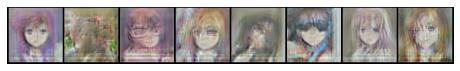

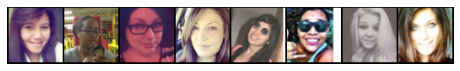

Epoch 6, Iteration 10, discriminator loss = 0.2811, generator loss = 48.5583
Epoch 6, Iteration 20, discriminator loss = 0.5192, generator loss = 43.6901
Epoch 6, Iteration 30, discriminator loss = 0.1058, generator loss = 39.8738
Epoch 6, Iteration 40, discriminator loss = 0.4533, generator loss = 44.7218
Epoch 6, Iteration 50, discriminator loss = 0.0821, generator loss = 44.7775
Epoch 6, Iteration 60, discriminator loss = 0.1421, generator loss = 49.2327
Epoch 6, Iteration 70, discriminator loss = 0.6826, generator loss = 45.7016
Epoch 6, Iteration 80, discriminator loss = 0.8912, generator loss = 41.8996
Epoch 6, Iteration 90, discriminator loss = 0.1686, generator loss = 50.6756
Epoch 6, Iteration 100, discriminator loss = 0.5776, generator loss = 46.3417


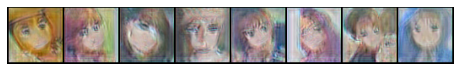

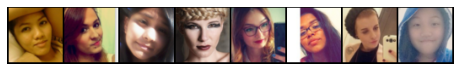

Epoch 6, Iteration 110, discriminator loss = 0.2556, generator loss = 45.0162
Epoch 6, Iteration 120, discriminator loss = 0.4595, generator loss = 47.9361
Epoch 6, Iteration 130, discriminator loss = 0.5455, generator loss = 39.9451
Epoch 6, Iteration 140, discriminator loss = 0.0420, generator loss = 52.1624
Epoch 6, Iteration 150, discriminator loss = 0.0774, generator loss = 41.2733
Epoch 6, Iteration 160, discriminator loss = 0.0853, generator loss = 52.1805
Epoch 6, Iteration 170, discriminator loss = 0.1286, generator loss = 50.0581
Epoch 6, Iteration 180, discriminator loss = 0.0687, generator loss = 43.0977
Epoch 6, Iteration 190, discriminator loss = 0.3613, generator loss = 42.7285
Epoch 6, Iteration 200, discriminator loss = 0.2620, generator loss = 49.2265


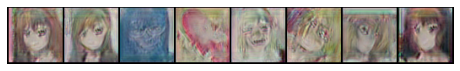

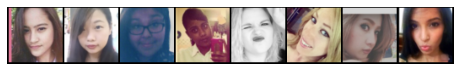

Epoch 6, Iteration 210, discriminator loss = 0.0572, generator loss = 45.2012
Epoch 6, Iteration 220, discriminator loss = 0.1039, generator loss = 43.9004
Epoch 6, Iteration 230, discriminator loss = 0.4581, generator loss = 39.9656
Epoch 6, Iteration 240, discriminator loss = 0.1703, generator loss = 43.6384
Epoch 6, Iteration 250, discriminator loss = 0.0476, generator loss = 45.3605
Epoch 6, Iteration 260, discriminator loss = 0.0931, generator loss = 47.1402
Epoch 6, Iteration 270, discriminator loss = 0.0468, generator loss = 47.8601
Epoch 6, Iteration 280, discriminator loss = 1.6045, generator loss = 44.5863
Epoch 6, Iteration 290, discriminator loss = 0.0780, generator loss = 45.3162
Epoch 6, Iteration 300, discriminator loss = 0.3545, generator loss = 44.7022


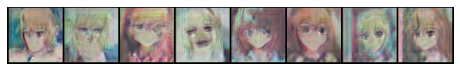

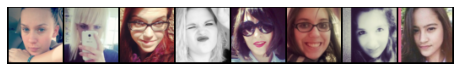

Epoch 6, Iteration 310, discriminator loss = 0.5467, generator loss = 40.9722
Epoch 6, Iteration 320, discriminator loss = 0.0777, generator loss = 42.2982
Epoch 6, Iteration 330, discriminator loss = 0.0204, generator loss = 50.5980
Epoch 6, Iteration 340, discriminator loss = 1.2371, generator loss = 51.6431
Epoch 6, Iteration 350, discriminator loss = 0.1347, generator loss = 43.9629
Epoch 6, Iteration 360, discriminator loss = 0.2071, generator loss = 45.0292
Epoch 6, Iteration 370, discriminator loss = 0.2217, generator loss = 44.0423
Epoch 6, Iteration 380, discriminator loss = 0.1653, generator loss = 41.9295
Epoch 6, Iteration 390, discriminator loss = 0.2135, generator loss = 52.1243
Epoch 6, Iteration 400, discriminator loss = 1.1347, generator loss = 45.1127


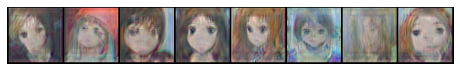

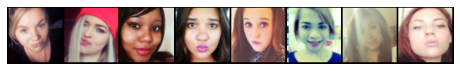

Epoch 6, Iteration 410, discriminator loss = 0.0501, generator loss = 50.6093
Epoch 6, Iteration 420, discriminator loss = 0.2461, generator loss = 46.4600
Epoch 7, Iteration 0, discriminator loss = 0.5942, generator loss = 44.3913


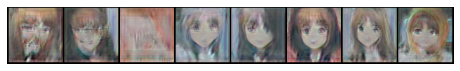

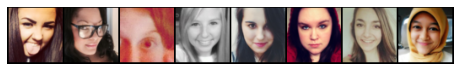

Epoch 7, Iteration 10, discriminator loss = 0.2565, generator loss = 54.5504
Epoch 7, Iteration 20, discriminator loss = 0.4504, generator loss = 51.3054
Epoch 7, Iteration 30, discriminator loss = 0.5312, generator loss = 45.6804
Epoch 7, Iteration 40, discriminator loss = 0.8117, generator loss = 45.1656
Epoch 7, Iteration 50, discriminator loss = 0.6455, generator loss = 46.6907
Epoch 7, Iteration 60, discriminator loss = 0.7820, generator loss = 45.6603
Epoch 7, Iteration 70, discriminator loss = 0.7499, generator loss = 43.8167
Epoch 7, Iteration 80, discriminator loss = 0.2068, generator loss = 44.5564
Epoch 7, Iteration 90, discriminator loss = 0.1914, generator loss = 40.5120
Epoch 7, Iteration 100, discriminator loss = 0.2456, generator loss = 40.8447


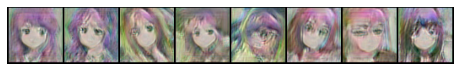

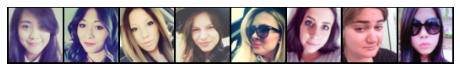

Epoch 7, Iteration 110, discriminator loss = 0.0569, generator loss = 44.5420
Epoch 7, Iteration 120, discriminator loss = 0.1061, generator loss = 44.2195
Epoch 7, Iteration 130, discriminator loss = 0.2222, generator loss = 47.3614
Epoch 7, Iteration 140, discriminator loss = 0.2044, generator loss = 48.3643
Epoch 7, Iteration 150, discriminator loss = 0.2422, generator loss = 45.4633
Epoch 7, Iteration 160, discriminator loss = 0.1342, generator loss = 50.4773
Epoch 7, Iteration 170, discriminator loss = 0.3843, generator loss = 46.2602
Epoch 7, Iteration 180, discriminator loss = 0.1556, generator loss = 45.0437
Epoch 7, Iteration 190, discriminator loss = 0.8955, generator loss = 48.2225
Epoch 7, Iteration 200, discriminator loss = 0.7016, generator loss = 39.0619


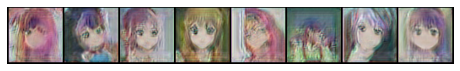

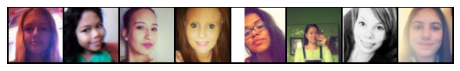

Epoch 7, Iteration 210, discriminator loss = 0.1162, generator loss = 42.6295
Epoch 7, Iteration 220, discriminator loss = 0.0327, generator loss = 49.5325
Epoch 7, Iteration 230, discriminator loss = 0.0785, generator loss = 47.7398
Epoch 7, Iteration 240, discriminator loss = 0.2431, generator loss = 47.6900
Epoch 7, Iteration 250, discriminator loss = 0.1716, generator loss = 43.9055
Epoch 7, Iteration 260, discriminator loss = 0.2391, generator loss = 42.4923
Epoch 7, Iteration 270, discriminator loss = 0.1314, generator loss = 42.7809
Epoch 7, Iteration 280, discriminator loss = 0.4853, generator loss = 41.1675
Epoch 7, Iteration 290, discriminator loss = 0.0500, generator loss = 44.6657
Epoch 7, Iteration 300, discriminator loss = 0.0262, generator loss = 44.0545


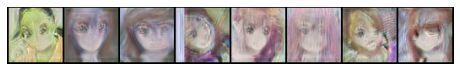

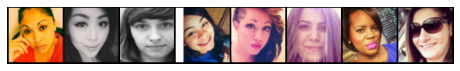

Epoch 7, Iteration 310, discriminator loss = 0.1112, generator loss = 45.9521
Epoch 7, Iteration 320, discriminator loss = 0.0965, generator loss = 47.6778
Epoch 7, Iteration 330, discriminator loss = 0.3302, generator loss = 48.1995
Epoch 7, Iteration 340, discriminator loss = 0.0524, generator loss = 43.0005
Epoch 7, Iteration 350, discriminator loss = 0.4121, generator loss = 43.1607
Epoch 7, Iteration 360, discriminator loss = 0.4139, generator loss = 53.8333
Epoch 7, Iteration 370, discriminator loss = 0.2957, generator loss = 51.4474
Epoch 7, Iteration 380, discriminator loss = 0.0895, generator loss = 43.5141
Epoch 7, Iteration 390, discriminator loss = 0.7158, generator loss = 43.3938
Epoch 7, Iteration 400, discriminator loss = 0.1435, generator loss = 51.4959


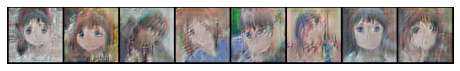

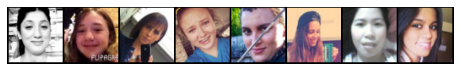

Epoch 7, Iteration 410, discriminator loss = 0.2836, generator loss = 52.4527
Epoch 7, Iteration 420, discriminator loss = 1.3411, generator loss = 50.0359
Epoch 8, Iteration 0, discriminator loss = 0.1642, generator loss = 42.1479


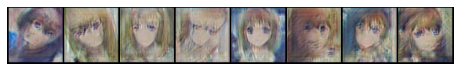

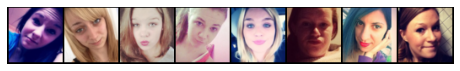

Epoch 8, Iteration 10, discriminator loss = 0.0498, generator loss = 48.3561
Epoch 8, Iteration 20, discriminator loss = 0.7200, generator loss = 46.0925
Epoch 8, Iteration 30, discriminator loss = 0.0210, generator loss = 46.3494
Epoch 8, Iteration 40, discriminator loss = 0.0771, generator loss = 44.6228
Epoch 8, Iteration 50, discriminator loss = 0.0534, generator loss = 47.4058
Epoch 8, Iteration 60, discriminator loss = 0.0963, generator loss = 42.7917
Epoch 8, Iteration 70, discriminator loss = 0.0479, generator loss = 46.3914
Epoch 8, Iteration 80, discriminator loss = 0.3023, generator loss = 49.5668
Epoch 8, Iteration 90, discriminator loss = 0.0444, generator loss = 44.8836
Epoch 8, Iteration 100, discriminator loss = 0.0121, generator loss = 43.9943


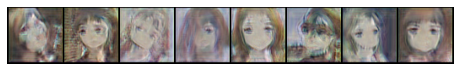

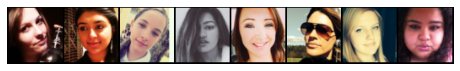

Epoch 8, Iteration 110, discriminator loss = 0.1365, generator loss = 46.1148
Epoch 8, Iteration 120, discriminator loss = 0.0996, generator loss = 45.2548
Epoch 8, Iteration 130, discriminator loss = 0.1019, generator loss = 53.4973
Epoch 8, Iteration 140, discriminator loss = 0.2891, generator loss = 46.2559
Epoch 8, Iteration 150, discriminator loss = 0.4353, generator loss = 50.1711
Epoch 8, Iteration 160, discriminator loss = 0.0478, generator loss = 44.3295
Epoch 8, Iteration 170, discriminator loss = 0.0534, generator loss = 47.7982
Epoch 8, Iteration 180, discriminator loss = 0.3583, generator loss = 53.4840
Epoch 8, Iteration 190, discriminator loss = 0.1769, generator loss = 50.6439
Epoch 8, Iteration 200, discriminator loss = 0.0231, generator loss = 47.3903


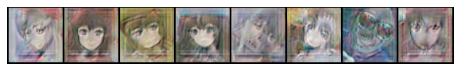

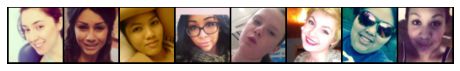

Epoch 8, Iteration 210, discriminator loss = 0.0223, generator loss = 46.8084
Epoch 8, Iteration 220, discriminator loss = 0.1893, generator loss = 42.8870
Epoch 8, Iteration 230, discriminator loss = 0.2046, generator loss = 48.1511
Epoch 8, Iteration 240, discriminator loss = 0.0698, generator loss = 49.3160
Epoch 8, Iteration 250, discriminator loss = 0.0454, generator loss = 45.1352
Epoch 8, Iteration 260, discriminator loss = 0.1712, generator loss = 38.1340
Epoch 8, Iteration 270, discriminator loss = 0.1923, generator loss = 46.1233
Epoch 8, Iteration 280, discriminator loss = 0.0339, generator loss = 43.2112
Epoch 8, Iteration 290, discriminator loss = 0.7666, generator loss = 51.5483
Epoch 8, Iteration 300, discriminator loss = 0.1635, generator loss = 51.1015


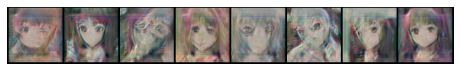

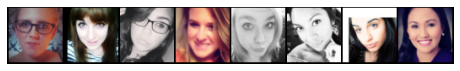

Epoch 8, Iteration 310, discriminator loss = 0.4861, generator loss = 42.7766
Epoch 8, Iteration 320, discriminator loss = 0.3409, generator loss = 44.1401
Epoch 8, Iteration 330, discriminator loss = 0.0847, generator loss = 47.3601
Epoch 8, Iteration 340, discriminator loss = 0.3049, generator loss = 50.0142
Epoch 8, Iteration 350, discriminator loss = 0.5767, generator loss = 41.9245
Epoch 8, Iteration 360, discriminator loss = 0.2438, generator loss = 44.8674
Epoch 8, Iteration 370, discriminator loss = 0.0164, generator loss = 45.0059
Epoch 8, Iteration 380, discriminator loss = 0.1844, generator loss = 42.5642
Epoch 8, Iteration 390, discriminator loss = 0.5475, generator loss = 47.0212
Epoch 8, Iteration 400, discriminator loss = 0.3963, generator loss = 40.2812


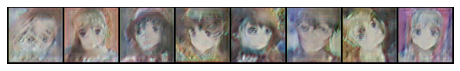

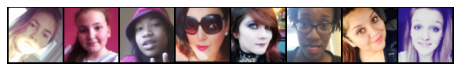

Epoch 8, Iteration 410, discriminator loss = 0.3961, generator loss = 42.4966
Epoch 8, Iteration 420, discriminator loss = 0.2846, generator loss = 46.9141
Epoch 9, Iteration 0, discriminator loss = 0.0138, generator loss = 42.8471


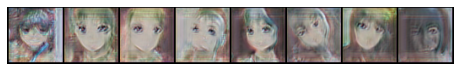

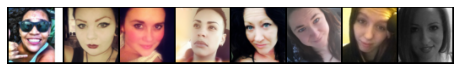

Epoch 9, Iteration 10, discriminator loss = 0.1856, generator loss = 53.2981
Epoch 9, Iteration 20, discriminator loss = 0.1636, generator loss = 43.1452
Epoch 9, Iteration 30, discriminator loss = 0.2677, generator loss = 46.9086
Epoch 9, Iteration 40, discriminator loss = 0.6851, generator loss = 45.7488
Epoch 9, Iteration 50, discriminator loss = 0.5739, generator loss = 48.0337
Epoch 9, Iteration 60, discriminator loss = 0.2533, generator loss = 47.6151
Epoch 9, Iteration 70, discriminator loss = 0.4777, generator loss = 47.3939
Epoch 9, Iteration 80, discriminator loss = 0.0541, generator loss = 46.2083
Epoch 9, Iteration 90, discriminator loss = 0.1930, generator loss = 41.8893
Epoch 9, Iteration 100, discriminator loss = 0.2615, generator loss = 48.7525


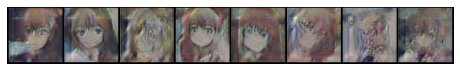

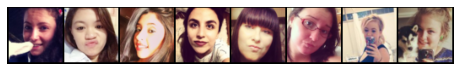

Epoch 9, Iteration 110, discriminator loss = 1.2589, generator loss = 37.5411
Epoch 9, Iteration 120, discriminator loss = 0.6916, generator loss = 40.9819
Epoch 9, Iteration 130, discriminator loss = 0.2965, generator loss = 40.9819
Epoch 9, Iteration 140, discriminator loss = 0.3443, generator loss = 36.8414
Epoch 9, Iteration 150, discriminator loss = 0.1416, generator loss = 46.4572
Epoch 9, Iteration 160, discriminator loss = 0.0325, generator loss = 44.4116
Epoch 9, Iteration 170, discriminator loss = 0.2557, generator loss = 44.7600
Epoch 9, Iteration 180, discriminator loss = 0.0593, generator loss = 43.0896
Epoch 9, Iteration 190, discriminator loss = 0.0102, generator loss = 47.0271
Epoch 9, Iteration 200, discriminator loss = 0.4406, generator loss = 46.8530


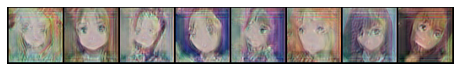

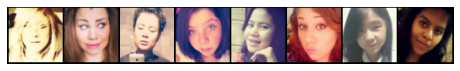

Epoch 9, Iteration 210, discriminator loss = 0.0054, generator loss = 50.8002
Epoch 9, Iteration 220, discriminator loss = 0.2295, generator loss = 52.0079
Epoch 9, Iteration 230, discriminator loss = 1.1692, generator loss = 40.6408
Epoch 9, Iteration 240, discriminator loss = 0.0073, generator loss = 42.9701
Epoch 9, Iteration 250, discriminator loss = 0.0844, generator loss = 46.1702
Epoch 9, Iteration 260, discriminator loss = 0.1113, generator loss = 42.2498
Epoch 9, Iteration 270, discriminator loss = 0.3921, generator loss = 44.2834
Epoch 9, Iteration 280, discriminator loss = 0.0925, generator loss = 38.3428
Epoch 9, Iteration 290, discriminator loss = 0.0678, generator loss = 44.9463
Epoch 9, Iteration 300, discriminator loss = 0.2194, generator loss = 48.4501


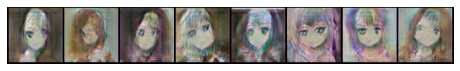

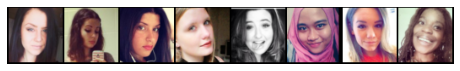

Epoch 9, Iteration 310, discriminator loss = 0.2388, generator loss = 40.7505
Epoch 9, Iteration 320, discriminator loss = 0.3583, generator loss = 43.4665
Epoch 9, Iteration 330, discriminator loss = 0.0641, generator loss = 36.9937
Epoch 9, Iteration 340, discriminator loss = 0.0461, generator loss = 44.6399
Epoch 9, Iteration 350, discriminator loss = 0.1732, generator loss = 48.1773
Epoch 9, Iteration 360, discriminator loss = 0.0155, generator loss = 43.1143
Epoch 9, Iteration 370, discriminator loss = 0.2355, generator loss = 46.5151
Epoch 9, Iteration 380, discriminator loss = 0.0661, generator loss = 38.2490
Epoch 9, Iteration 390, discriminator loss = 0.0096, generator loss = 43.6953
Epoch 9, Iteration 400, discriminator loss = 0.1363, generator loss = 40.9733


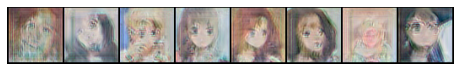

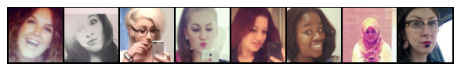

Epoch 9, Iteration 410, discriminator loss = 0.0314, generator loss = 45.7805
Epoch 9, Iteration 420, discriminator loss = 0.2291, generator loss = 38.3314
Epoch 10, Iteration 0, discriminator loss = 0.0451, generator loss = 43.9616


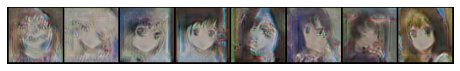

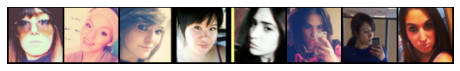

Epoch 10, Iteration 10, discriminator loss = 0.1188, generator loss = 44.5644
Epoch 10, Iteration 20, discriminator loss = 0.3015, generator loss = 48.6369
Epoch 10, Iteration 30, discriminator loss = 0.1225, generator loss = 37.9199
Epoch 10, Iteration 40, discriminator loss = 1.3032, generator loss = 34.6092
Epoch 10, Iteration 50, discriminator loss = 0.2443, generator loss = 48.0791
Epoch 10, Iteration 60, discriminator loss = 0.2001, generator loss = 48.1728
Epoch 10, Iteration 70, discriminator loss = 0.0181, generator loss = 43.6350
Epoch 10, Iteration 80, discriminator loss = 0.0671, generator loss = 44.3805
Epoch 10, Iteration 90, discriminator loss = 1.0268, generator loss = 33.0969
Epoch 10, Iteration 100, discriminator loss = 0.1680, generator loss = 46.0472


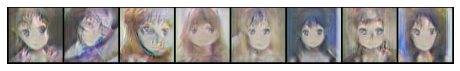

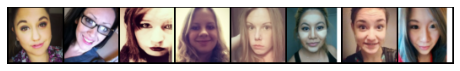

Epoch 10, Iteration 110, discriminator loss = 0.2164, generator loss = 44.4502
Epoch 10, Iteration 120, discriminator loss = 0.1396, generator loss = 44.0395
Epoch 10, Iteration 130, discriminator loss = 0.3618, generator loss = 45.8760
Epoch 10, Iteration 140, discriminator loss = 0.0457, generator loss = 50.9531
Epoch 10, Iteration 150, discriminator loss = 1.2360, generator loss = 37.3755
Epoch 10, Iteration 160, discriminator loss = 0.1626, generator loss = 51.9573
Epoch 10, Iteration 170, discriminator loss = 0.1125, generator loss = 41.1004
Epoch 10, Iteration 180, discriminator loss = 0.7649, generator loss = 46.6841
Epoch 10, Iteration 190, discriminator loss = 0.0122, generator loss = 55.2643
Epoch 10, Iteration 200, discriminator loss = 0.0592, generator loss = 41.7252


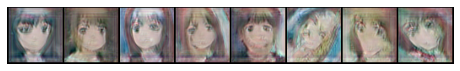

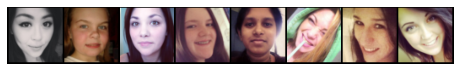

Epoch 10, Iteration 210, discriminator loss = 0.1894, generator loss = 49.2397
Epoch 10, Iteration 220, discriminator loss = 0.0670, generator loss = 45.0948
Epoch 10, Iteration 230, discriminator loss = 0.2223, generator loss = 44.5712
Epoch 10, Iteration 240, discriminator loss = 0.5357, generator loss = 48.3416
Epoch 10, Iteration 250, discriminator loss = 3.4704, generator loss = 48.7265
Epoch 10, Iteration 260, discriminator loss = 0.0141, generator loss = 47.5565
Epoch 10, Iteration 270, discriminator loss = 0.0489, generator loss = 46.6609
Epoch 10, Iteration 280, discriminator loss = 0.1988, generator loss = 41.7325
Epoch 10, Iteration 290, discriminator loss = 0.4523, generator loss = 47.1894
Epoch 10, Iteration 300, discriminator loss = 0.1994, generator loss = 51.1959


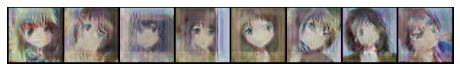

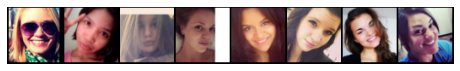

Epoch 10, Iteration 310, discriminator loss = 1.5566, generator loss = 38.4231
Epoch 10, Iteration 320, discriminator loss = 0.3061, generator loss = 43.9294
Epoch 10, Iteration 330, discriminator loss = 0.2223, generator loss = 49.5804
Epoch 10, Iteration 340, discriminator loss = 0.3962, generator loss = 48.0413
Epoch 10, Iteration 350, discriminator loss = 0.3259, generator loss = 38.6169
Epoch 10, Iteration 360, discriminator loss = 0.1376, generator loss = 40.2923
Epoch 10, Iteration 370, discriminator loss = 0.7512, generator loss = 43.0243
Epoch 10, Iteration 380, discriminator loss = 0.1258, generator loss = 41.0967
Epoch 10, Iteration 390, discriminator loss = 0.1699, generator loss = 39.9377
Epoch 10, Iteration 400, discriminator loss = 0.0552, generator loss = 42.9710


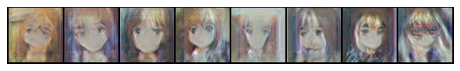

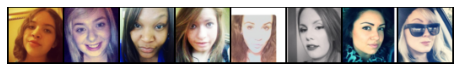

Epoch 10, Iteration 410, discriminator loss = 0.0274, generator loss = 44.0697
Epoch 10, Iteration 420, discriminator loss = 0.1654, generator loss = 44.2232
Epoch 11, Iteration 0, discriminator loss = 0.1348, generator loss = 40.8196


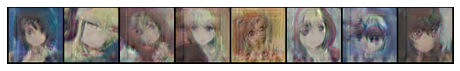

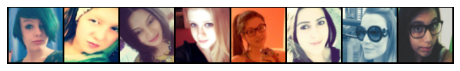

Epoch 11, Iteration 10, discriminator loss = 0.2363, generator loss = 39.3314
Epoch 11, Iteration 20, discriminator loss = 0.1069, generator loss = 48.5854
Epoch 11, Iteration 30, discriminator loss = 0.0612, generator loss = 46.3895
Epoch 11, Iteration 40, discriminator loss = 0.0713, generator loss = 38.8175
Epoch 11, Iteration 50, discriminator loss = 0.2065, generator loss = 40.0803
Epoch 11, Iteration 60, discriminator loss = 0.0553, generator loss = 46.3581
Epoch 11, Iteration 70, discriminator loss = 0.7244, generator loss = 45.2955
Epoch 11, Iteration 80, discriminator loss = 0.0080, generator loss = 45.7853
Epoch 11, Iteration 90, discriminator loss = 0.2145, generator loss = 47.1387
Epoch 11, Iteration 100, discriminator loss = 0.6776, generator loss = 47.8540


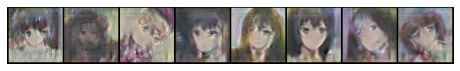

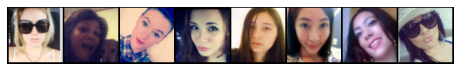

Epoch 11, Iteration 110, discriminator loss = 0.4219, generator loss = 39.9742
Epoch 11, Iteration 120, discriminator loss = 0.3987, generator loss = 46.2713
Epoch 11, Iteration 130, discriminator loss = 0.3070, generator loss = 47.4434
Epoch 11, Iteration 140, discriminator loss = 0.3890, generator loss = 39.2166
Epoch 11, Iteration 150, discriminator loss = 0.0831, generator loss = 44.0438
Epoch 11, Iteration 160, discriminator loss = 0.0508, generator loss = 45.5136
Epoch 11, Iteration 170, discriminator loss = 1.1188, generator loss = 47.9813
Epoch 11, Iteration 180, discriminator loss = 0.4193, generator loss = 41.7017
Epoch 11, Iteration 190, discriminator loss = 0.1069, generator loss = 48.5834
Epoch 11, Iteration 200, discriminator loss = 0.2542, generator loss = 45.6776


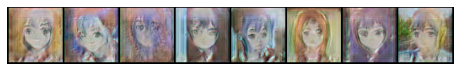

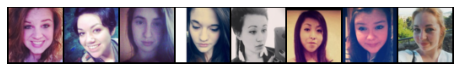

Epoch 11, Iteration 210, discriminator loss = 0.4001, generator loss = 52.0686
Epoch 11, Iteration 220, discriminator loss = 0.1047, generator loss = 46.2568
Epoch 11, Iteration 230, discriminator loss = 0.0926, generator loss = 40.4829
Epoch 11, Iteration 240, discriminator loss = 0.1001, generator loss = 44.0226
Epoch 11, Iteration 250, discriminator loss = 0.0497, generator loss = 41.2590
Epoch 11, Iteration 260, discriminator loss = 0.2560, generator loss = 44.5077
Epoch 11, Iteration 270, discriminator loss = 0.1031, generator loss = 45.4430
Epoch 11, Iteration 280, discriminator loss = 0.0136, generator loss = 39.2873
Epoch 11, Iteration 290, discriminator loss = 0.1186, generator loss = 41.3082
Epoch 11, Iteration 300, discriminator loss = 0.4897, generator loss = 42.3125


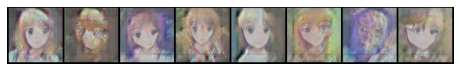

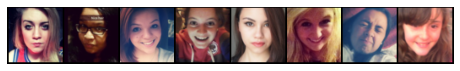

Epoch 11, Iteration 310, discriminator loss = 1.4256, generator loss = 52.4012
Epoch 11, Iteration 320, discriminator loss = 0.0589, generator loss = 57.9534
Epoch 11, Iteration 330, discriminator loss = 0.1444, generator loss = 52.4318
Epoch 11, Iteration 340, discriminator loss = 0.3449, generator loss = 43.6855
Epoch 11, Iteration 350, discriminator loss = 0.2914, generator loss = 41.6079
Epoch 11, Iteration 360, discriminator loss = 0.0110, generator loss = 51.1702
Epoch 11, Iteration 370, discriminator loss = 0.2082, generator loss = 42.0466
Epoch 11, Iteration 380, discriminator loss = 0.3673, generator loss = 41.5681
Epoch 11, Iteration 390, discriminator loss = 0.0817, generator loss = 39.4756
Epoch 11, Iteration 400, discriminator loss = 0.4976, generator loss = 41.7695


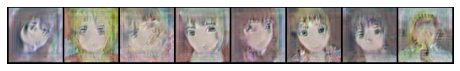

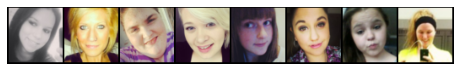

Epoch 11, Iteration 410, discriminator loss = 0.2427, generator loss = 39.1335
Epoch 11, Iteration 420, discriminator loss = 0.0126, generator loss = 48.1151
Epoch 12, Iteration 0, discriminator loss = 0.4006, generator loss = 43.6531


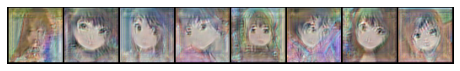

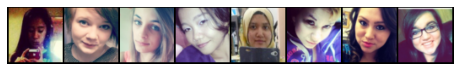

Epoch 12, Iteration 10, discriminator loss = 0.3184, generator loss = 48.3280
Epoch 12, Iteration 20, discriminator loss = 0.1049, generator loss = 40.4660
Epoch 12, Iteration 30, discriminator loss = 1.3254, generator loss = 44.6450
Epoch 12, Iteration 40, discriminator loss = 0.1099, generator loss = 39.5073
Epoch 12, Iteration 50, discriminator loss = 0.5244, generator loss = 40.5195
Epoch 12, Iteration 60, discriminator loss = 0.0269, generator loss = 45.8079
Epoch 12, Iteration 70, discriminator loss = 0.5680, generator loss = 44.7928
Epoch 12, Iteration 80, discriminator loss = 0.2010, generator loss = 44.7302
Epoch 12, Iteration 90, discriminator loss = 0.1739, generator loss = 47.3928
Epoch 12, Iteration 100, discriminator loss = 0.6183, generator loss = 49.4359


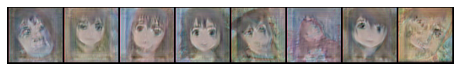

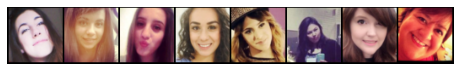

Epoch 12, Iteration 110, discriminator loss = 0.0739, generator loss = 40.3655
Epoch 12, Iteration 120, discriminator loss = 0.4017, generator loss = 37.1416
Epoch 12, Iteration 130, discriminator loss = 0.0936, generator loss = 39.0010
Epoch 12, Iteration 140, discriminator loss = 0.0540, generator loss = 48.5631
Epoch 12, Iteration 150, discriminator loss = 0.1327, generator loss = 44.6553
Epoch 12, Iteration 160, discriminator loss = 0.1180, generator loss = 42.5088
Epoch 12, Iteration 170, discriminator loss = 0.1608, generator loss = 51.3651
Epoch 12, Iteration 180, discriminator loss = 0.0765, generator loss = 43.5065
Epoch 12, Iteration 190, discriminator loss = 0.0255, generator loss = 47.4219
Epoch 12, Iteration 200, discriminator loss = 0.0264, generator loss = 47.4121


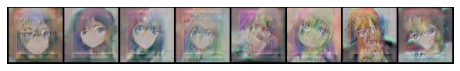

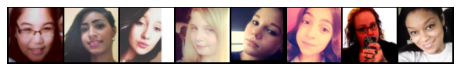

Epoch 12, Iteration 210, discriminator loss = 0.1243, generator loss = 46.3544
Epoch 12, Iteration 220, discriminator loss = 0.0470, generator loss = 45.0130
Epoch 12, Iteration 230, discriminator loss = 0.3602, generator loss = 56.4282
Epoch 12, Iteration 240, discriminator loss = 0.0216, generator loss = 47.7026
Epoch 12, Iteration 250, discriminator loss = 0.0799, generator loss = 51.1684
Epoch 12, Iteration 260, discriminator loss = 0.1936, generator loss = 49.1140
Epoch 12, Iteration 270, discriminator loss = 0.3318, generator loss = 53.3165
Epoch 12, Iteration 280, discriminator loss = 0.0317, generator loss = 51.7262
Epoch 12, Iteration 290, discriminator loss = 0.3353, generator loss = 39.4379
Epoch 12, Iteration 300, discriminator loss = 0.1393, generator loss = 40.0676


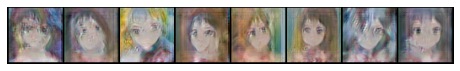

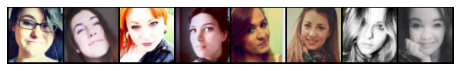

Epoch 12, Iteration 310, discriminator loss = 0.1420, generator loss = 45.3442
Epoch 12, Iteration 320, discriminator loss = 0.0987, generator loss = 36.8172
Epoch 12, Iteration 330, discriminator loss = 0.3365, generator loss = 44.1423
Epoch 12, Iteration 340, discriminator loss = 0.0252, generator loss = 46.8020
Epoch 12, Iteration 350, discriminator loss = 0.3007, generator loss = 43.9291
Epoch 12, Iteration 360, discriminator loss = 0.1703, generator loss = 47.0912
Epoch 12, Iteration 370, discriminator loss = 0.2231, generator loss = 44.3884
Epoch 12, Iteration 380, discriminator loss = 1.8080, generator loss = 43.7294
Epoch 12, Iteration 390, discriminator loss = 0.2019, generator loss = 47.5831
Epoch 12, Iteration 400, discriminator loss = 0.0320, generator loss = 41.4294


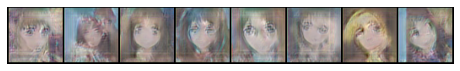

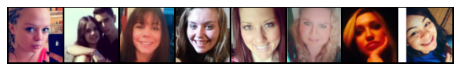

Epoch 12, Iteration 410, discriminator loss = 0.3259, generator loss = 41.3791
Epoch 12, Iteration 420, discriminator loss = 0.0998, generator loss = 46.3183
Epoch 13, Iteration 0, discriminator loss = 0.8213, generator loss = 44.2242


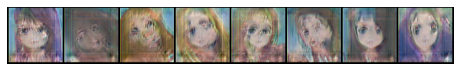

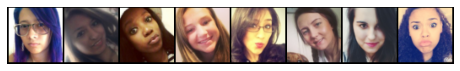

Epoch 13, Iteration 10, discriminator loss = 0.3414, generator loss = 46.3196
Epoch 13, Iteration 20, discriminator loss = 0.4000, generator loss = 37.4761
Epoch 13, Iteration 30, discriminator loss = 0.3440, generator loss = 40.9707
Epoch 13, Iteration 40, discriminator loss = 0.0963, generator loss = 49.0200
Epoch 13, Iteration 50, discriminator loss = 0.0255, generator loss = 55.4618
Epoch 13, Iteration 60, discriminator loss = 0.0538, generator loss = 45.9910
Epoch 13, Iteration 70, discriminator loss = 0.0703, generator loss = 41.4207
Epoch 13, Iteration 80, discriminator loss = 0.1206, generator loss = 44.6634
Epoch 13, Iteration 90, discriminator loss = 0.0316, generator loss = 45.7448
Epoch 13, Iteration 100, discriminator loss = 0.0170, generator loss = 46.5710


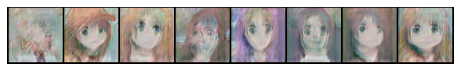

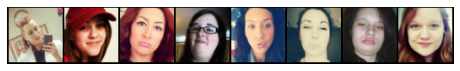

Epoch 13, Iteration 110, discriminator loss = 0.1255, generator loss = 37.4202
Epoch 13, Iteration 120, discriminator loss = 0.0813, generator loss = 44.6672
Epoch 13, Iteration 130, discriminator loss = 0.1505, generator loss = 40.7188
Epoch 13, Iteration 140, discriminator loss = 0.1463, generator loss = 38.7943
Epoch 13, Iteration 150, discriminator loss = 0.0035, generator loss = 49.0808
Epoch 13, Iteration 160, discriminator loss = 0.0075, generator loss = 42.7277
Epoch 13, Iteration 170, discriminator loss = 0.0405, generator loss = 41.4683
Epoch 13, Iteration 180, discriminator loss = 0.2469, generator loss = 42.0035
Epoch 13, Iteration 190, discriminator loss = 0.4789, generator loss = 39.7872
Epoch 13, Iteration 200, discriminator loss = 0.9116, generator loss = 50.0815


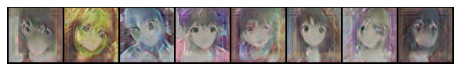

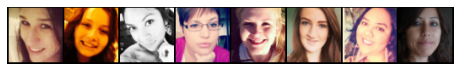

Epoch 13, Iteration 210, discriminator loss = 0.4214, generator loss = 40.2827
Epoch 13, Iteration 220, discriminator loss = 0.0104, generator loss = 52.2508
Epoch 13, Iteration 230, discriminator loss = 0.1821, generator loss = 39.2810
Epoch 13, Iteration 240, discriminator loss = 0.0407, generator loss = 48.5220
Epoch 13, Iteration 250, discriminator loss = 0.0213, generator loss = 44.3152
Epoch 13, Iteration 260, discriminator loss = 0.0550, generator loss = 44.3016
Epoch 13, Iteration 270, discriminator loss = 0.0915, generator loss = 52.1701
Epoch 13, Iteration 280, discriminator loss = 0.7151, generator loss = 42.9648
Epoch 13, Iteration 290, discriminator loss = 0.0202, generator loss = 44.2998
Epoch 13, Iteration 300, discriminator loss = 0.1789, generator loss = 39.1853


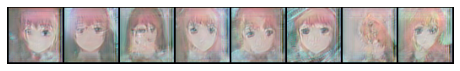

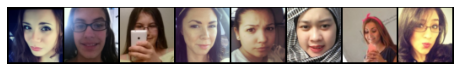

Epoch 13, Iteration 310, discriminator loss = 0.6804, generator loss = 48.0109
Epoch 13, Iteration 320, discriminator loss = 0.3125, generator loss = 37.8151
Epoch 13, Iteration 330, discriminator loss = 0.2872, generator loss = 42.9350
Epoch 13, Iteration 340, discriminator loss = 0.0725, generator loss = 41.6864
Epoch 13, Iteration 350, discriminator loss = 0.8666, generator loss = 45.1433
Epoch 13, Iteration 360, discriminator loss = 1.0067, generator loss = 46.2859
Epoch 13, Iteration 370, discriminator loss = 1.0642, generator loss = 43.5311
Epoch 13, Iteration 380, discriminator loss = 0.0785, generator loss = 40.5015
Epoch 13, Iteration 390, discriminator loss = 0.5686, generator loss = 40.4533
Epoch 13, Iteration 400, discriminator loss = 0.1947, generator loss = 36.8209


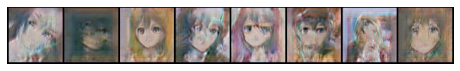

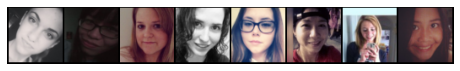

Epoch 13, Iteration 410, discriminator loss = 0.5433, generator loss = 44.5301
Epoch 13, Iteration 420, discriminator loss = 0.1664, generator loss = 41.9881
Epoch 14, Iteration 0, discriminator loss = 0.0474, generator loss = 51.7467


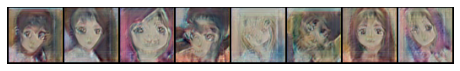

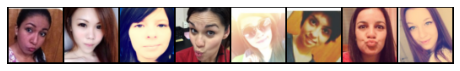

Epoch 14, Iteration 10, discriminator loss = 0.2144, generator loss = 41.8997
Epoch 14, Iteration 20, discriminator loss = 0.3812, generator loss = 42.9928
Epoch 14, Iteration 30, discriminator loss = 0.3088, generator loss = 39.0580
Epoch 14, Iteration 40, discriminator loss = 1.0203, generator loss = 38.3465
Epoch 14, Iteration 50, discriminator loss = 0.1853, generator loss = 42.4116
Epoch 14, Iteration 60, discriminator loss = 0.5605, generator loss = 46.5859
Epoch 14, Iteration 70, discriminator loss = 0.0146, generator loss = 46.7790
Epoch 14, Iteration 80, discriminator loss = 0.1570, generator loss = 42.2382
Epoch 14, Iteration 90, discriminator loss = 0.0903, generator loss = 42.9994
Epoch 14, Iteration 100, discriminator loss = 0.1458, generator loss = 47.3433


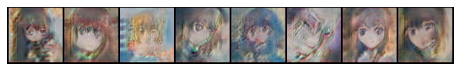

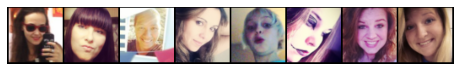

Epoch 14, Iteration 110, discriminator loss = 0.0353, generator loss = 49.3551
Epoch 14, Iteration 120, discriminator loss = 0.1263, generator loss = 44.9066
Epoch 14, Iteration 130, discriminator loss = 0.4643, generator loss = 45.2502
Epoch 14, Iteration 140, discriminator loss = 0.0329, generator loss = 41.6993
Epoch 14, Iteration 150, discriminator loss = 0.1719, generator loss = 55.3678
Epoch 14, Iteration 160, discriminator loss = 0.2641, generator loss = 41.7157
Epoch 14, Iteration 170, discriminator loss = 0.5164, generator loss = 46.2771
Epoch 14, Iteration 180, discriminator loss = 0.1315, generator loss = 54.7455
Epoch 14, Iteration 190, discriminator loss = 0.0750, generator loss = 46.3440
Epoch 14, Iteration 200, discriminator loss = 0.0953, generator loss = 41.2448


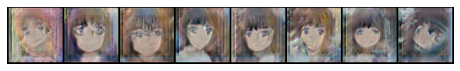

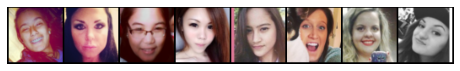

Epoch 14, Iteration 210, discriminator loss = 0.0409, generator loss = 39.8653
Epoch 14, Iteration 220, discriminator loss = 0.0946, generator loss = 46.1891
Epoch 14, Iteration 230, discriminator loss = 0.1832, generator loss = 42.4030
Epoch 14, Iteration 240, discriminator loss = 0.5139, generator loss = 37.1634
Epoch 14, Iteration 250, discriminator loss = 0.0832, generator loss = 39.9758
Epoch 14, Iteration 260, discriminator loss = 0.5069, generator loss = 53.9099
Epoch 14, Iteration 270, discriminator loss = 0.3831, generator loss = 45.4018
Epoch 14, Iteration 280, discriminator loss = 0.0555, generator loss = 47.1759
Epoch 14, Iteration 290, discriminator loss = 0.0475, generator loss = 39.2441
Epoch 14, Iteration 300, discriminator loss = 0.0725, generator loss = 45.4316


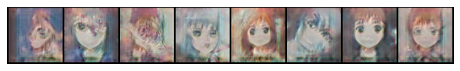

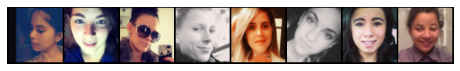

Epoch 14, Iteration 310, discriminator loss = 0.1450, generator loss = 41.0499
Epoch 14, Iteration 320, discriminator loss = 0.0434, generator loss = 51.6701
Epoch 14, Iteration 330, discriminator loss = 0.0140, generator loss = 45.5068
Epoch 14, Iteration 340, discriminator loss = 0.0494, generator loss = 47.2236
Epoch 14, Iteration 350, discriminator loss = 0.0355, generator loss = 51.3035
Epoch 14, Iteration 360, discriminator loss = 0.0751, generator loss = 46.1984
Epoch 14, Iteration 370, discriminator loss = 0.0082, generator loss = 46.5392
Epoch 14, Iteration 380, discriminator loss = 0.5359, generator loss = 44.3556
Epoch 14, Iteration 390, discriminator loss = 0.1772, generator loss = 45.9982
Epoch 14, Iteration 400, discriminator loss = 0.0235, generator loss = 42.4538


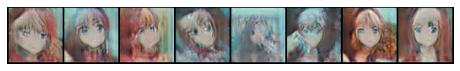

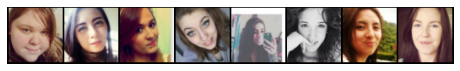

Epoch 14, Iteration 410, discriminator loss = 0.3674, generator loss = 40.4014
Epoch 14, Iteration 420, discriminator loss = 0.6345, generator loss = 40.3093
Epoch 15, Iteration 0, discriminator loss = 0.6513, generator loss = 47.4841


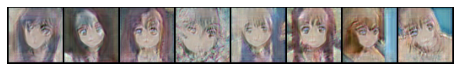

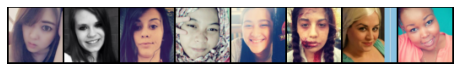

Epoch 15, Iteration 10, discriminator loss = 0.0677, generator loss = 46.5713
Epoch 15, Iteration 20, discriminator loss = 0.0632, generator loss = 42.1849
Epoch 15, Iteration 30, discriminator loss = 0.3585, generator loss = 44.0062
Epoch 15, Iteration 40, discriminator loss = 0.5250, generator loss = 50.9742
Epoch 15, Iteration 50, discriminator loss = 0.1872, generator loss = 45.6663
Epoch 15, Iteration 60, discriminator loss = 0.9696, generator loss = 38.0353
Epoch 15, Iteration 70, discriminator loss = 1.0849, generator loss = 44.2177
Epoch 15, Iteration 80, discriminator loss = 0.5079, generator loss = 52.4452
Epoch 15, Iteration 90, discriminator loss = 0.1164, generator loss = 44.3479
Epoch 15, Iteration 100, discriminator loss = 0.1257, generator loss = 47.4356


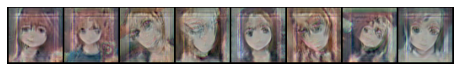

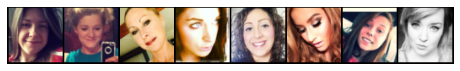

Epoch 15, Iteration 110, discriminator loss = 0.0649, generator loss = 42.1421
Epoch 15, Iteration 120, discriminator loss = 0.4309, generator loss = 42.5314
Epoch 15, Iteration 130, discriminator loss = 0.0296, generator loss = 43.7866
Epoch 15, Iteration 140, discriminator loss = 0.0512, generator loss = 36.4951
Epoch 15, Iteration 150, discriminator loss = 0.0316, generator loss = 44.9522
Epoch 15, Iteration 160, discriminator loss = 0.1863, generator loss = 50.6142
Epoch 15, Iteration 170, discriminator loss = 0.1353, generator loss = 48.5654
Epoch 15, Iteration 180, discriminator loss = 0.9403, generator loss = 46.9638
Epoch 15, Iteration 190, discriminator loss = 1.1955, generator loss = 41.8965
Epoch 15, Iteration 200, discriminator loss = 0.5842, generator loss = 45.5204


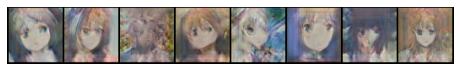

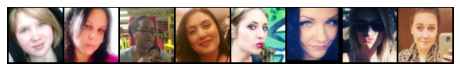

Epoch 15, Iteration 210, discriminator loss = 0.1366, generator loss = 52.9018
Epoch 15, Iteration 220, discriminator loss = 0.2763, generator loss = 47.9056
Epoch 15, Iteration 230, discriminator loss = 0.0295, generator loss = 46.6407
Epoch 15, Iteration 240, discriminator loss = 0.0506, generator loss = 49.2197
Epoch 15, Iteration 250, discriminator loss = 0.0118, generator loss = 39.0042
Epoch 15, Iteration 260, discriminator loss = 0.3845, generator loss = 45.4394
Epoch 15, Iteration 270, discriminator loss = 0.4271, generator loss = 46.5510
Epoch 15, Iteration 280, discriminator loss = 0.0130, generator loss = 47.6511
Epoch 15, Iteration 290, discriminator loss = 0.0519, generator loss = 40.2828
Epoch 15, Iteration 300, discriminator loss = 0.2007, generator loss = 44.3935


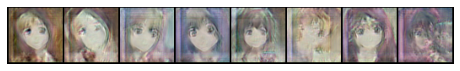

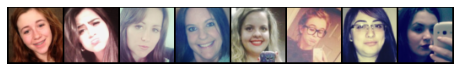

Epoch 15, Iteration 310, discriminator loss = 0.1893, generator loss = 39.1082
Epoch 15, Iteration 320, discriminator loss = 0.0231, generator loss = 49.8538
Epoch 15, Iteration 330, discriminator loss = 0.0350, generator loss = 44.4464
Epoch 15, Iteration 340, discriminator loss = 0.0638, generator loss = 39.6821
Epoch 15, Iteration 350, discriminator loss = 0.0955, generator loss = 41.9361
Epoch 15, Iteration 360, discriminator loss = 0.0517, generator loss = 40.9510
Epoch 15, Iteration 370, discriminator loss = 0.2849, generator loss = 38.7738
Epoch 15, Iteration 380, discriminator loss = 0.0240, generator loss = 49.3944
Epoch 15, Iteration 390, discriminator loss = 0.0205, generator loss = 41.3998
Epoch 15, Iteration 400, discriminator loss = 0.0494, generator loss = 53.8357


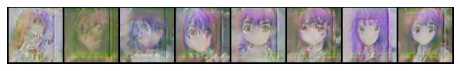

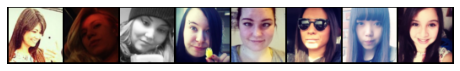

Epoch 15, Iteration 410, discriminator loss = 0.1183, generator loss = 46.3199
Epoch 15, Iteration 420, discriminator loss = 0.0772, generator loss = 50.4711
Epoch 16, Iteration 0, discriminator loss = 0.1080, generator loss = 48.5662


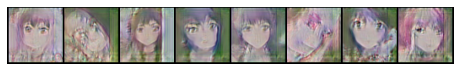

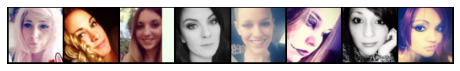

Epoch 16, Iteration 10, discriminator loss = 0.3413, generator loss = 59.0566
Epoch 16, Iteration 20, discriminator loss = 0.0711, generator loss = 53.7461
Epoch 16, Iteration 30, discriminator loss = 0.1532, generator loss = 40.6562
Epoch 16, Iteration 40, discriminator loss = 0.0251, generator loss = 47.3710
Epoch 16, Iteration 50, discriminator loss = 0.0122, generator loss = 47.0490
Epoch 16, Iteration 60, discriminator loss = 1.1453, generator loss = 42.1725
Epoch 16, Iteration 70, discriminator loss = 0.0107, generator loss = 47.0486
Epoch 16, Iteration 80, discriminator loss = 0.0662, generator loss = 39.0942
Epoch 16, Iteration 90, discriminator loss = 0.0155, generator loss = 43.9713
Epoch 16, Iteration 100, discriminator loss = 0.2385, generator loss = 40.8061


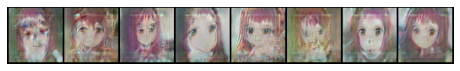

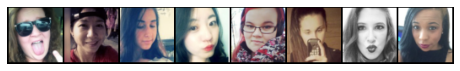

Epoch 16, Iteration 110, discriminator loss = 0.0892, generator loss = 44.4741
Epoch 16, Iteration 120, discriminator loss = 0.0930, generator loss = 38.7954
Epoch 16, Iteration 130, discriminator loss = 0.1721, generator loss = 40.4106
Epoch 16, Iteration 140, discriminator loss = 0.0049, generator loss = 40.9869
Epoch 16, Iteration 150, discriminator loss = 0.1530, generator loss = 40.8666
Epoch 16, Iteration 160, discriminator loss = 0.1777, generator loss = 42.5525
Epoch 16, Iteration 170, discriminator loss = 0.0304, generator loss = 40.8650
Epoch 16, Iteration 180, discriminator loss = 0.0903, generator loss = 39.8786
Epoch 16, Iteration 190, discriminator loss = 0.0939, generator loss = 43.8412
Epoch 16, Iteration 200, discriminator loss = 0.0460, generator loss = 44.2522


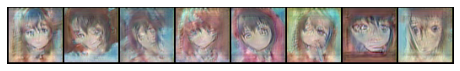

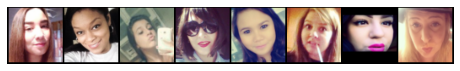

Epoch 16, Iteration 210, discriminator loss = 0.2511, generator loss = 46.2689
Epoch 16, Iteration 220, discriminator loss = 0.1258, generator loss = 47.4865
Epoch 16, Iteration 230, discriminator loss = 0.4248, generator loss = 40.7223
Epoch 16, Iteration 240, discriminator loss = 0.0270, generator loss = 44.1879
Epoch 16, Iteration 250, discriminator loss = 0.0344, generator loss = 41.3367
Epoch 16, Iteration 260, discriminator loss = 0.0301, generator loss = 43.0898
Epoch 16, Iteration 270, discriminator loss = 0.0148, generator loss = 45.8336
Epoch 16, Iteration 280, discriminator loss = 0.0698, generator loss = 46.8109
Epoch 16, Iteration 290, discriminator loss = 0.0016, generator loss = 46.9458
Epoch 16, Iteration 300, discriminator loss = 0.0551, generator loss = 48.0386


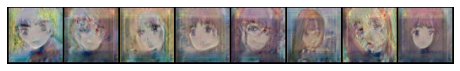

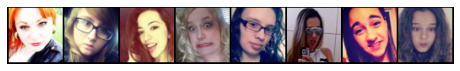

Epoch 16, Iteration 310, discriminator loss = 0.1362, generator loss = 39.9032
Epoch 16, Iteration 320, discriminator loss = 0.3642, generator loss = 41.6800
Epoch 16, Iteration 330, discriminator loss = 0.5883, generator loss = 45.5694
Epoch 16, Iteration 340, discriminator loss = 0.2706, generator loss = 42.0621
Epoch 16, Iteration 350, discriminator loss = 0.0748, generator loss = 37.4527
Epoch 16, Iteration 360, discriminator loss = 3.5377, generator loss = 42.4741
Epoch 16, Iteration 370, discriminator loss = 0.0407, generator loss = 34.9582
Epoch 16, Iteration 380, discriminator loss = 0.2437, generator loss = 36.6452
Epoch 16, Iteration 390, discriminator loss = 0.1739, generator loss = 49.4023
Epoch 16, Iteration 400, discriminator loss = 0.0765, generator loss = 47.9387


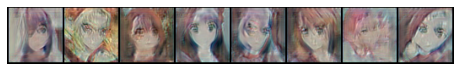

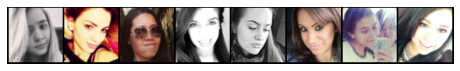

Epoch 16, Iteration 410, discriminator loss = 0.0195, generator loss = 45.0760
Epoch 16, Iteration 420, discriminator loss = 0.0212, generator loss = 45.3250
Epoch 17, Iteration 0, discriminator loss = 0.0459, generator loss = 46.9791


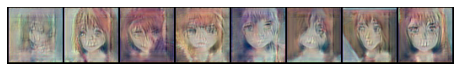

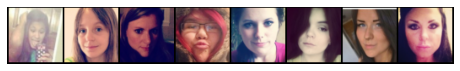

Epoch 17, Iteration 10, discriminator loss = 0.1503, generator loss = 49.4815
Epoch 17, Iteration 20, discriminator loss = 0.1282, generator loss = 43.2022
Epoch 17, Iteration 30, discriminator loss = 0.0318, generator loss = 45.1482
Epoch 17, Iteration 40, discriminator loss = 0.0498, generator loss = 40.2023
Epoch 17, Iteration 50, discriminator loss = 0.6218, generator loss = 40.5115
Epoch 17, Iteration 60, discriminator loss = 0.0565, generator loss = 41.8260
Epoch 17, Iteration 70, discriminator loss = 0.0570, generator loss = 51.4598
Epoch 17, Iteration 80, discriminator loss = 0.0096, generator loss = 53.8778
Epoch 17, Iteration 90, discriminator loss = 0.1555, generator loss = 43.6402
Epoch 17, Iteration 100, discriminator loss = 0.0865, generator loss = 39.0190


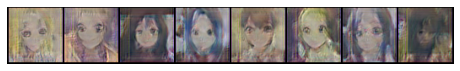

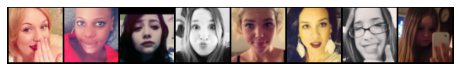

Epoch 17, Iteration 110, discriminator loss = 0.0609, generator loss = 47.6737
Epoch 17, Iteration 120, discriminator loss = 0.0085, generator loss = 44.4773
Epoch 17, Iteration 130, discriminator loss = 0.8620, generator loss = 39.2589
Epoch 17, Iteration 140, discriminator loss = 0.0890, generator loss = 42.2253
Epoch 17, Iteration 150, discriminator loss = 0.2999, generator loss = 45.0210
Epoch 17, Iteration 160, discriminator loss = 0.0770, generator loss = 51.1108
Epoch 17, Iteration 170, discriminator loss = 0.2387, generator loss = 44.8268
Epoch 17, Iteration 180, discriminator loss = 0.0383, generator loss = 44.1297
Epoch 17, Iteration 190, discriminator loss = 0.3132, generator loss = 44.9440
Epoch 17, Iteration 200, discriminator loss = 0.3307, generator loss = 39.3515


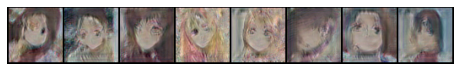

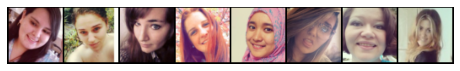

Epoch 17, Iteration 210, discriminator loss = 0.0215, generator loss = 40.8759
Epoch 17, Iteration 220, discriminator loss = 0.0873, generator loss = 49.6639
Epoch 17, Iteration 230, discriminator loss = 1.0393, generator loss = 43.4056
Epoch 17, Iteration 240, discriminator loss = 0.2020, generator loss = 45.7583
Epoch 17, Iteration 250, discriminator loss = 0.0276, generator loss = 49.0523
Epoch 17, Iteration 260, discriminator loss = 0.2444, generator loss = 57.9932
Epoch 17, Iteration 270, discriminator loss = 0.0513, generator loss = 41.5353
Epoch 17, Iteration 280, discriminator loss = 0.1921, generator loss = 47.8336
Epoch 17, Iteration 290, discriminator loss = 0.0633, generator loss = 48.8663
Epoch 17, Iteration 300, discriminator loss = 0.7559, generator loss = 55.6505


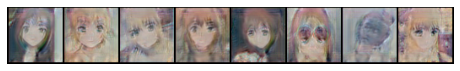

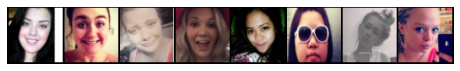

Epoch 17, Iteration 310, discriminator loss = 0.0812, generator loss = 42.1983
Epoch 17, Iteration 320, discriminator loss = 0.2085, generator loss = 37.6686
Epoch 17, Iteration 330, discriminator loss = 0.0951, generator loss = 41.6838
Epoch 17, Iteration 340, discriminator loss = 0.0823, generator loss = 44.1098
Epoch 17, Iteration 350, discriminator loss = 1.4588, generator loss = 50.7639
Epoch 17, Iteration 360, discriminator loss = 0.0277, generator loss = 51.0669
Epoch 17, Iteration 370, discriminator loss = 0.7051, generator loss = 58.6761
Epoch 17, Iteration 380, discriminator loss = 0.2497, generator loss = 40.3925
Epoch 17, Iteration 390, discriminator loss = 0.8059, generator loss = 39.4891
Epoch 17, Iteration 400, discriminator loss = 0.0210, generator loss = 47.8314


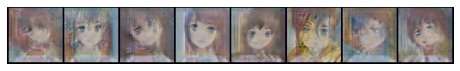

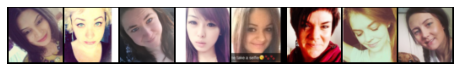

Epoch 17, Iteration 410, discriminator loss = 0.1470, generator loss = 44.7148
Epoch 17, Iteration 420, discriminator loss = 0.0441, generator loss = 43.9626
Epoch 18, Iteration 0, discriminator loss = 0.1796, generator loss = 40.4675


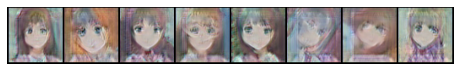

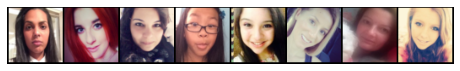

Epoch 18, Iteration 10, discriminator loss = 0.0522, generator loss = 46.1946
Epoch 18, Iteration 20, discriminator loss = 0.0060, generator loss = 48.7608
Epoch 18, Iteration 30, discriminator loss = 0.0757, generator loss = 44.6346
Epoch 18, Iteration 40, discriminator loss = 0.5985, generator loss = 55.1609
Epoch 18, Iteration 50, discriminator loss = 0.2058, generator loss = 42.7180
Epoch 18, Iteration 60, discriminator loss = 0.0345, generator loss = 43.1153
Epoch 18, Iteration 70, discriminator loss = 0.0396, generator loss = 41.3119
Epoch 18, Iteration 80, discriminator loss = 0.3039, generator loss = 45.0463
Epoch 18, Iteration 90, discriminator loss = 0.1213, generator loss = 42.5452
Epoch 18, Iteration 100, discriminator loss = 0.1021, generator loss = 48.9803


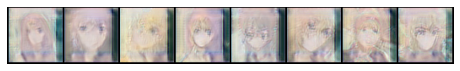

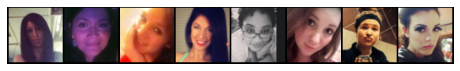

Epoch 18, Iteration 110, discriminator loss = 0.0837, generator loss = 44.0201
Epoch 18, Iteration 120, discriminator loss = 0.0276, generator loss = 45.4654
Epoch 18, Iteration 130, discriminator loss = 0.0551, generator loss = 52.7522
Epoch 18, Iteration 140, discriminator loss = 0.0689, generator loss = 51.6714
Epoch 18, Iteration 150, discriminator loss = 1.2779, generator loss = 39.0929
Epoch 18, Iteration 160, discriminator loss = 0.0447, generator loss = 40.8235
Epoch 18, Iteration 170, discriminator loss = 0.4499, generator loss = 45.3942
Epoch 18, Iteration 180, discriminator loss = 0.0452, generator loss = 39.1370
Epoch 18, Iteration 190, discriminator loss = 0.0795, generator loss = 36.6479
Epoch 18, Iteration 200, discriminator loss = 0.0419, generator loss = 38.8820


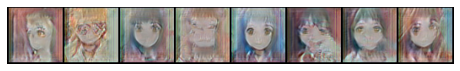

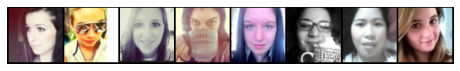

Epoch 18, Iteration 210, discriminator loss = 0.1302, generator loss = 39.2439
Epoch 18, Iteration 220, discriminator loss = 0.1405, generator loss = 43.2677
Epoch 18, Iteration 230, discriminator loss = 0.2882, generator loss = 35.7901
Epoch 18, Iteration 240, discriminator loss = 0.3009, generator loss = 37.1899
Epoch 18, Iteration 250, discriminator loss = 0.2504, generator loss = 37.9167
Epoch 18, Iteration 260, discriminator loss = 0.1936, generator loss = 40.5080
Epoch 18, Iteration 270, discriminator loss = 0.0171, generator loss = 39.4203
Epoch 18, Iteration 280, discriminator loss = 0.2732, generator loss = 43.7435
Epoch 18, Iteration 290, discriminator loss = 0.1774, generator loss = 40.5467
Epoch 18, Iteration 300, discriminator loss = 0.0170, generator loss = 49.0724


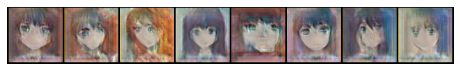

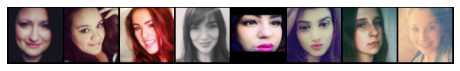

Epoch 18, Iteration 310, discriminator loss = 0.1460, generator loss = 41.0578
Epoch 18, Iteration 320, discriminator loss = 0.4508, generator loss = 43.7699
Epoch 18, Iteration 330, discriminator loss = 0.0361, generator loss = 44.1543
Epoch 18, Iteration 340, discriminator loss = 0.0247, generator loss = 47.5250
Epoch 18, Iteration 350, discriminator loss = 0.1110, generator loss = 39.9180
Epoch 18, Iteration 360, discriminator loss = 0.0219, generator loss = 42.3316
Epoch 18, Iteration 370, discriminator loss = 0.6006, generator loss = 46.8271
Epoch 18, Iteration 380, discriminator loss = 0.0938, generator loss = 41.5510
Epoch 18, Iteration 390, discriminator loss = 0.0775, generator loss = 37.6733
Epoch 18, Iteration 400, discriminator loss = 0.7057, generator loss = 46.7577


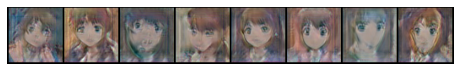

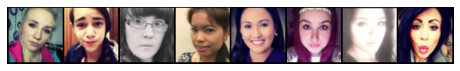

Epoch 18, Iteration 410, discriminator loss = 0.0489, generator loss = 40.7249
Epoch 18, Iteration 420, discriminator loss = 0.3084, generator loss = 44.3828
Epoch 19, Iteration 0, discriminator loss = 0.0329, generator loss = 38.9035


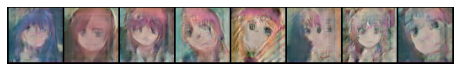

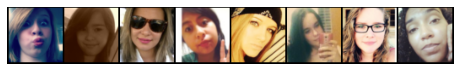

Epoch 19, Iteration 10, discriminator loss = 0.1090, generator loss = 46.8398
Epoch 19, Iteration 20, discriminator loss = 0.3357, generator loss = 36.4509
Epoch 19, Iteration 30, discriminator loss = 0.1846, generator loss = 41.7453
Epoch 19, Iteration 40, discriminator loss = 0.1486, generator loss = 41.7917
Epoch 19, Iteration 50, discriminator loss = 0.1383, generator loss = 43.9452
Epoch 19, Iteration 60, discriminator loss = 0.1049, generator loss = 35.8568
Epoch 19, Iteration 70, discriminator loss = 0.4892, generator loss = 52.0677
Epoch 19, Iteration 80, discriminator loss = 0.0426, generator loss = 42.9161
Epoch 19, Iteration 90, discriminator loss = 0.6523, generator loss = 39.3582
Epoch 19, Iteration 100, discriminator loss = 0.0837, generator loss = 39.7420


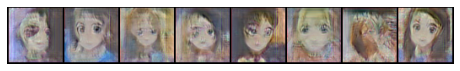

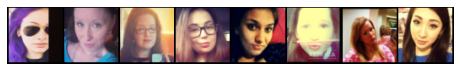

Epoch 19, Iteration 110, discriminator loss = 0.5658, generator loss = 45.8615
Epoch 19, Iteration 120, discriminator loss = 0.2997, generator loss = 40.9957
Epoch 19, Iteration 130, discriminator loss = 0.3231, generator loss = 41.8482
Epoch 19, Iteration 140, discriminator loss = 0.0550, generator loss = 38.8397
Epoch 19, Iteration 150, discriminator loss = 0.1551, generator loss = 35.9559
Epoch 19, Iteration 160, discriminator loss = 0.3284, generator loss = 39.8777
Epoch 19, Iteration 170, discriminator loss = 0.0314, generator loss = 41.2725
Epoch 19, Iteration 180, discriminator loss = 0.0185, generator loss = 40.2738
Epoch 19, Iteration 190, discriminator loss = 0.2498, generator loss = 45.5136
Epoch 19, Iteration 200, discriminator loss = 0.0209, generator loss = 41.5966


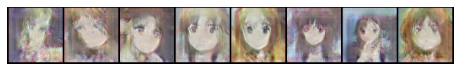

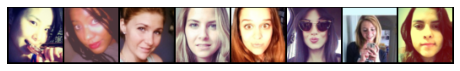

Epoch 19, Iteration 210, discriminator loss = 0.1476, generator loss = 39.6439
Epoch 19, Iteration 220, discriminator loss = 0.1109, generator loss = 41.8455
Epoch 19, Iteration 230, discriminator loss = 0.0522, generator loss = 50.5404
Epoch 19, Iteration 240, discriminator loss = 0.0361, generator loss = 51.3027
Epoch 19, Iteration 250, discriminator loss = 0.0401, generator loss = 44.7385
Epoch 19, Iteration 260, discriminator loss = 0.0820, generator loss = 42.6952
Epoch 19, Iteration 270, discriminator loss = 0.1547, generator loss = 44.3610
Epoch 19, Iteration 280, discriminator loss = 0.2009, generator loss = 40.1332
Epoch 19, Iteration 290, discriminator loss = 0.7092, generator loss = 40.7357
Epoch 19, Iteration 300, discriminator loss = 0.1440, generator loss = 38.4532


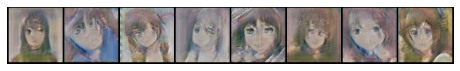

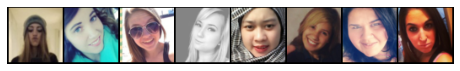

Epoch 19, Iteration 310, discriminator loss = 0.0510, generator loss = 38.9714
Epoch 19, Iteration 320, discriminator loss = 0.1311, generator loss = 40.4571
Epoch 19, Iteration 330, discriminator loss = 0.3128, generator loss = 45.0312
Epoch 19, Iteration 340, discriminator loss = 0.1914, generator loss = 38.2790
Epoch 19, Iteration 350, discriminator loss = 0.0087, generator loss = 48.9930
Epoch 19, Iteration 360, discriminator loss = 0.0436, generator loss = 48.1289
Epoch 19, Iteration 370, discriminator loss = 0.0339, generator loss = 40.2783
Epoch 19, Iteration 380, discriminator loss = 0.0428, generator loss = 45.3402
Epoch 19, Iteration 390, discriminator loss = 0.0221, generator loss = 43.7549
Epoch 19, Iteration 400, discriminator loss = 0.0062, generator loss = 46.1183


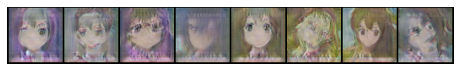

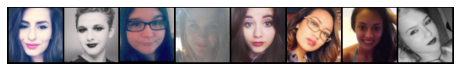

Epoch 19, Iteration 410, discriminator loss = 0.1219, generator loss = 39.0777
Epoch 19, Iteration 420, discriminator loss = 0.0095, generator loss = 44.0793
Epoch 20, Iteration 0, discriminator loss = 0.1778, generator loss = 45.9822


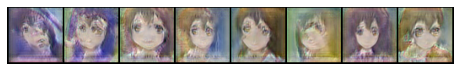

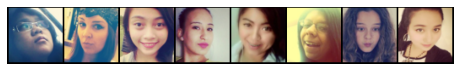

Epoch 20, Iteration 10, discriminator loss = 1.4148, generator loss = 49.8066
Epoch 20, Iteration 20, discriminator loss = 0.2321, generator loss = 39.6246
Epoch 20, Iteration 30, discriminator loss = 0.0909, generator loss = 42.1143
Epoch 20, Iteration 40, discriminator loss = 0.2203, generator loss = 38.1875
Epoch 20, Iteration 50, discriminator loss = 0.0029, generator loss = 50.6022
Epoch 20, Iteration 60, discriminator loss = 0.0409, generator loss = 38.7873
Epoch 20, Iteration 70, discriminator loss = 0.2532, generator loss = 46.8955
Epoch 20, Iteration 80, discriminator loss = 2.4684, generator loss = 43.0228
Epoch 20, Iteration 90, discriminator loss = 1.5030, generator loss = 45.8316
Epoch 20, Iteration 100, discriminator loss = 0.0295, generator loss = 50.9525


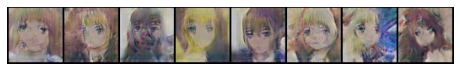

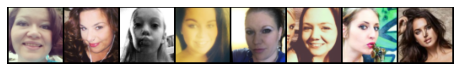

Epoch 20, Iteration 110, discriminator loss = 0.6459, generator loss = 40.0840
Epoch 20, Iteration 120, discriminator loss = 0.0172, generator loss = 47.6288
Epoch 20, Iteration 130, discriminator loss = 0.5219, generator loss = 47.8747
Epoch 20, Iteration 140, discriminator loss = 0.0431, generator loss = 42.7626
Epoch 20, Iteration 150, discriminator loss = 0.0534, generator loss = 47.2684
Epoch 20, Iteration 160, discriminator loss = 0.1523, generator loss = 37.6697
Epoch 20, Iteration 170, discriminator loss = 0.8126, generator loss = 49.9240
Epoch 20, Iteration 180, discriminator loss = 0.0087, generator loss = 56.0971
Epoch 20, Iteration 190, discriminator loss = 0.0194, generator loss = 44.1885
Epoch 20, Iteration 200, discriminator loss = 0.0855, generator loss = 42.5136


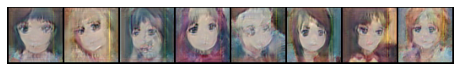

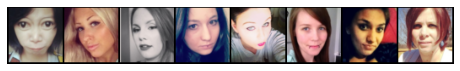

Epoch 20, Iteration 210, discriminator loss = 0.0282, generator loss = 40.4147
Epoch 20, Iteration 220, discriminator loss = 0.0180, generator loss = 38.1575
Epoch 20, Iteration 230, discriminator loss = 0.4528, generator loss = 42.1513
Epoch 20, Iteration 240, discriminator loss = 0.0842, generator loss = 41.6014
Epoch 20, Iteration 250, discriminator loss = 0.0122, generator loss = 45.9772
Epoch 20, Iteration 260, discriminator loss = 0.1237, generator loss = 52.7617
Epoch 20, Iteration 270, discriminator loss = 0.4947, generator loss = 44.2999
Epoch 20, Iteration 280, discriminator loss = 0.1024, generator loss = 47.4544
Epoch 20, Iteration 290, discriminator loss = 0.0520, generator loss = 41.3042
Epoch 20, Iteration 300, discriminator loss = 0.0084, generator loss = 41.6577


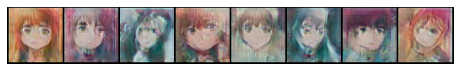

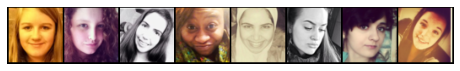

Epoch 20, Iteration 310, discriminator loss = 0.6433, generator loss = 38.4911
Epoch 20, Iteration 320, discriminator loss = 0.4409, generator loss = 53.8404
Epoch 20, Iteration 330, discriminator loss = 0.0699, generator loss = 45.4705
Epoch 20, Iteration 340, discriminator loss = 0.0784, generator loss = 43.4254
Epoch 20, Iteration 350, discriminator loss = 0.0689, generator loss = 39.2313
Epoch 20, Iteration 360, discriminator loss = 0.0302, generator loss = 51.4889
Epoch 20, Iteration 370, discriminator loss = 0.0784, generator loss = 45.4204
Epoch 20, Iteration 380, discriminator loss = 0.0034, generator loss = 45.4322
Epoch 20, Iteration 390, discriminator loss = 0.1585, generator loss = 37.8669
Epoch 20, Iteration 400, discriminator loss = 0.6348, generator loss = 40.2868


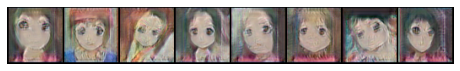

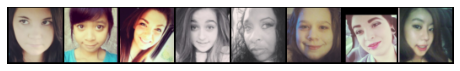

Epoch 20, Iteration 410, discriminator loss = 0.0299, generator loss = 40.8248
Epoch 20, Iteration 420, discriminator loss = 0.0315, generator loss = 58.6184
Epoch 21, Iteration 0, discriminator loss = 0.2234, generator loss = 38.2979


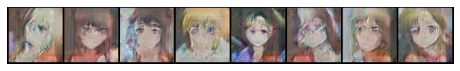

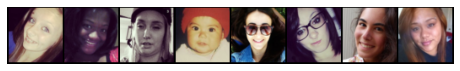

Epoch 21, Iteration 10, discriminator loss = 0.0129, generator loss = 43.7129
Epoch 21, Iteration 20, discriminator loss = 0.0876, generator loss = 48.2604
Epoch 21, Iteration 30, discriminator loss = 0.0109, generator loss = 42.5142
Epoch 21, Iteration 40, discriminator loss = 0.0163, generator loss = 42.6057
Epoch 21, Iteration 50, discriminator loss = 0.0847, generator loss = 40.4046
Epoch 21, Iteration 60, discriminator loss = 0.8198, generator loss = 43.5409
Epoch 21, Iteration 70, discriminator loss = 0.0101, generator loss = 45.4821
Epoch 21, Iteration 80, discriminator loss = 0.0581, generator loss = 45.9588
Epoch 21, Iteration 90, discriminator loss = 0.0355, generator loss = 49.2421
Epoch 21, Iteration 100, discriminator loss = 0.0431, generator loss = 43.4791


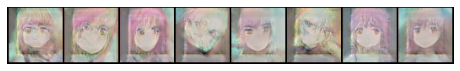

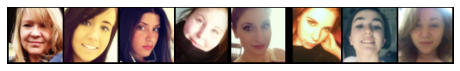

Epoch 21, Iteration 110, discriminator loss = 0.2144, generator loss = 48.7514
Epoch 21, Iteration 120, discriminator loss = 0.0007, generator loss = 51.3783
Epoch 21, Iteration 130, discriminator loss = 0.1582, generator loss = 50.9046
Epoch 21, Iteration 140, discriminator loss = 0.0338, generator loss = 49.7678
Epoch 21, Iteration 150, discriminator loss = 0.6220, generator loss = 50.3403
Epoch 21, Iteration 160, discriminator loss = 0.0316, generator loss = 44.1955
Epoch 21, Iteration 170, discriminator loss = 0.0036, generator loss = 45.6781
Epoch 21, Iteration 180, discriminator loss = 0.0164, generator loss = 42.0050
Epoch 21, Iteration 190, discriminator loss = 0.0079, generator loss = 51.0366
Epoch 21, Iteration 200, discriminator loss = 0.3733, generator loss = 56.1301


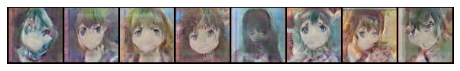

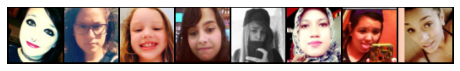

Epoch 21, Iteration 210, discriminator loss = 3.0377, generator loss = 46.2601
Epoch 21, Iteration 220, discriminator loss = 0.0933, generator loss = 48.0392
Epoch 21, Iteration 230, discriminator loss = 0.0263, generator loss = 46.3194
Epoch 21, Iteration 240, discriminator loss = 0.0953, generator loss = 42.2160
Epoch 21, Iteration 250, discriminator loss = 1.4183, generator loss = 46.0006
Epoch 21, Iteration 260, discriminator loss = 0.1409, generator loss = 41.1395
Epoch 21, Iteration 270, discriminator loss = 0.0794, generator loss = 43.6114
Epoch 21, Iteration 280, discriminator loss = 0.0347, generator loss = 42.4615
Epoch 21, Iteration 290, discriminator loss = 0.0802, generator loss = 39.6111
Epoch 21, Iteration 300, discriminator loss = 0.3487, generator loss = 48.2406


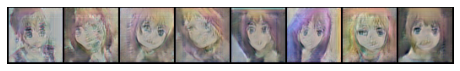

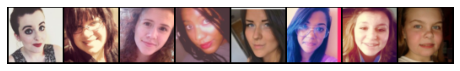

Epoch 21, Iteration 310, discriminator loss = 0.8237, generator loss = 45.4900
Epoch 21, Iteration 320, discriminator loss = 0.2460, generator loss = 41.2557
Epoch 21, Iteration 330, discriminator loss = 0.0647, generator loss = 41.5579
Epoch 21, Iteration 340, discriminator loss = 0.1594, generator loss = 39.4812
Epoch 21, Iteration 350, discriminator loss = 0.2285, generator loss = 39.7285
Epoch 21, Iteration 360, discriminator loss = 0.0865, generator loss = 43.6277
Epoch 21, Iteration 370, discriminator loss = 0.9724, generator loss = 46.5461
Epoch 21, Iteration 380, discriminator loss = 0.0282, generator loss = 43.0332
Epoch 21, Iteration 390, discriminator loss = 0.1211, generator loss = 36.4921
Epoch 21, Iteration 400, discriminator loss = 0.3475, generator loss = 42.4017


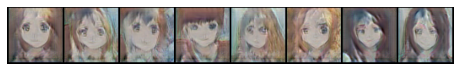

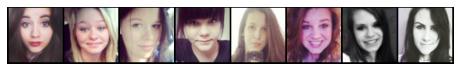

Epoch 21, Iteration 410, discriminator loss = 0.0565, generator loss = 41.4262
Epoch 21, Iteration 420, discriminator loss = 0.0337, generator loss = 35.1493
Epoch 22, Iteration 0, discriminator loss = 0.2246, generator loss = 38.1409


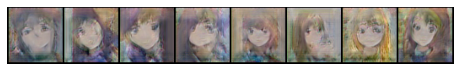

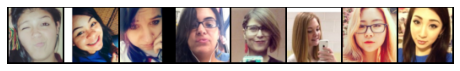

Epoch 22, Iteration 10, discriminator loss = 0.0954, generator loss = 35.8523
Epoch 22, Iteration 20, discriminator loss = 0.1331, generator loss = 38.9682
Epoch 22, Iteration 30, discriminator loss = 0.2502, generator loss = 40.2500
Epoch 22, Iteration 40, discriminator loss = 0.0975, generator loss = 42.2989
Epoch 22, Iteration 50, discriminator loss = 0.0133, generator loss = 45.9106
Epoch 22, Iteration 60, discriminator loss = 0.2184, generator loss = 40.9823
Epoch 22, Iteration 70, discriminator loss = 0.5319, generator loss = 44.8135
Epoch 22, Iteration 80, discriminator loss = 0.0529, generator loss = 42.6222
Epoch 22, Iteration 90, discriminator loss = 0.8135, generator loss = 44.6686
Epoch 22, Iteration 100, discriminator loss = 0.0950, generator loss = 42.9631


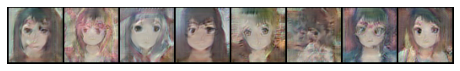

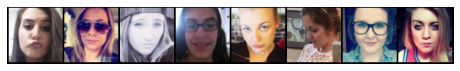

Epoch 22, Iteration 110, discriminator loss = 0.0745, generator loss = 43.9409
Epoch 22, Iteration 120, discriminator loss = 0.0113, generator loss = 43.4174
Epoch 22, Iteration 130, discriminator loss = 0.0111, generator loss = 43.9713
Epoch 22, Iteration 140, discriminator loss = 0.0148, generator loss = 39.6471
Epoch 22, Iteration 150, discriminator loss = 0.0165, generator loss = 39.1551
Epoch 22, Iteration 160, discriminator loss = 0.0194, generator loss = 44.6526
Epoch 22, Iteration 170, discriminator loss = 0.1323, generator loss = 49.7038
Epoch 22, Iteration 180, discriminator loss = 0.0737, generator loss = 45.7281
Epoch 22, Iteration 190, discriminator loss = 0.3595, generator loss = 37.6224
Epoch 22, Iteration 200, discriminator loss = 0.0254, generator loss = 37.9391


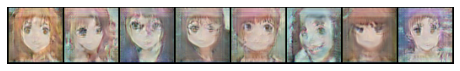

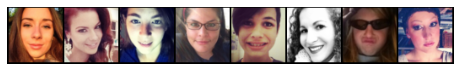

Epoch 22, Iteration 210, discriminator loss = 0.1780, generator loss = 53.4997
Epoch 22, Iteration 220, discriminator loss = 0.2575, generator loss = 43.2557
Epoch 22, Iteration 230, discriminator loss = 0.0425, generator loss = 39.7317
Epoch 22, Iteration 240, discriminator loss = 0.2139, generator loss = 41.8981
Epoch 22, Iteration 250, discriminator loss = 0.0093, generator loss = 39.2255
Epoch 22, Iteration 260, discriminator loss = 0.2094, generator loss = 45.6475
Epoch 22, Iteration 270, discriminator loss = 0.0991, generator loss = 44.3736
Epoch 22, Iteration 280, discriminator loss = 0.5965, generator loss = 42.1931
Epoch 22, Iteration 290, discriminator loss = 0.0595, generator loss = 44.6607
Epoch 22, Iteration 300, discriminator loss = 0.0255, generator loss = 47.2500


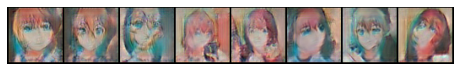

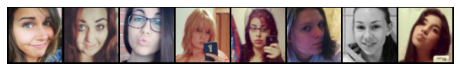

Epoch 22, Iteration 310, discriminator loss = 0.0731, generator loss = 39.3110
Epoch 22, Iteration 320, discriminator loss = 0.0158, generator loss = 37.8418
Epoch 22, Iteration 330, discriminator loss = 0.0467, generator loss = 41.1657
Epoch 22, Iteration 340, discriminator loss = 0.2350, generator loss = 45.5676
Epoch 22, Iteration 350, discriminator loss = 0.0249, generator loss = 38.6905
Epoch 22, Iteration 360, discriminator loss = 0.0142, generator loss = 39.6787
Epoch 22, Iteration 370, discriminator loss = 0.2051, generator loss = 45.8455
Epoch 22, Iteration 380, discriminator loss = 0.0202, generator loss = 38.9148
Epoch 22, Iteration 390, discriminator loss = 0.1791, generator loss = 45.6801
Epoch 22, Iteration 400, discriminator loss = 0.5188, generator loss = 48.3871


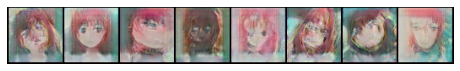

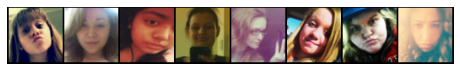

Epoch 22, Iteration 410, discriminator loss = 0.2379, generator loss = 39.7200
Epoch 22, Iteration 420, discriminator loss = 0.0977, generator loss = 47.3711
Epoch 23, Iteration 0, discriminator loss = 0.1536, generator loss = 43.0237


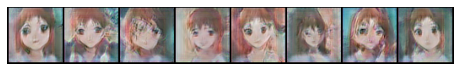

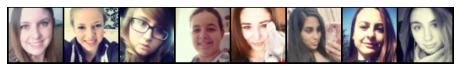

Epoch 23, Iteration 10, discriminator loss = 0.0746, generator loss = 45.1946
Epoch 23, Iteration 20, discriminator loss = 0.4296, generator loss = 40.5264
Epoch 23, Iteration 30, discriminator loss = 0.1364, generator loss = 47.8296
Epoch 23, Iteration 40, discriminator loss = 0.5152, generator loss = 36.6092
Epoch 23, Iteration 50, discriminator loss = 0.0129, generator loss = 40.7382
Epoch 23, Iteration 60, discriminator loss = 0.3100, generator loss = 43.5959
Epoch 23, Iteration 70, discriminator loss = 0.0292, generator loss = 40.0165
Epoch 23, Iteration 80, discriminator loss = 0.5797, generator loss = 46.6515
Epoch 23, Iteration 90, discriminator loss = 0.7978, generator loss = 40.8978
Epoch 23, Iteration 100, discriminator loss = 0.0399, generator loss = 38.9024


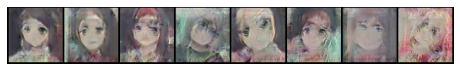

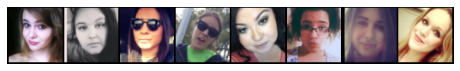

Epoch 23, Iteration 110, discriminator loss = 0.0354, generator loss = 41.5568
Epoch 23, Iteration 120, discriminator loss = 0.0023, generator loss = 48.1902
Epoch 23, Iteration 130, discriminator loss = 0.0757, generator loss = 44.5135
Epoch 23, Iteration 140, discriminator loss = 0.0827, generator loss = 40.1726
Epoch 23, Iteration 150, discriminator loss = 0.0299, generator loss = 40.4565
Epoch 23, Iteration 160, discriminator loss = 0.0759, generator loss = 46.6780
Epoch 23, Iteration 170, discriminator loss = 0.0323, generator loss = 42.2728
Epoch 23, Iteration 180, discriminator loss = 0.1954, generator loss = 40.2822
Epoch 23, Iteration 190, discriminator loss = 0.1760, generator loss = 35.9258
Epoch 23, Iteration 200, discriminator loss = 0.0412, generator loss = 39.3514


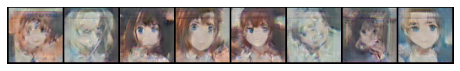

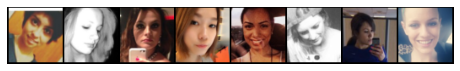

Epoch 23, Iteration 210, discriminator loss = 0.0252, generator loss = 50.5444
Epoch 23, Iteration 220, discriminator loss = 0.0455, generator loss = 38.3738
Epoch 23, Iteration 230, discriminator loss = 0.0131, generator loss = 42.6774
Epoch 23, Iteration 240, discriminator loss = 0.0058, generator loss = 49.6293
Epoch 23, Iteration 250, discriminator loss = 0.0082, generator loss = 45.8069
Epoch 23, Iteration 260, discriminator loss = 0.1008, generator loss = 46.2385
Epoch 23, Iteration 270, discriminator loss = 0.1157, generator loss = 36.4984
Epoch 23, Iteration 280, discriminator loss = 0.0270, generator loss = 45.8478
Epoch 23, Iteration 290, discriminator loss = 0.1880, generator loss = 44.8633
Epoch 23, Iteration 300, discriminator loss = 0.0211, generator loss = 53.2521


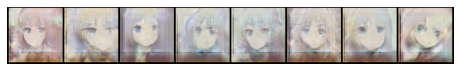

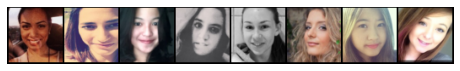

Epoch 23, Iteration 310, discriminator loss = 0.5653, generator loss = 42.4210
Epoch 23, Iteration 320, discriminator loss = 0.0309, generator loss = 50.3993
Epoch 23, Iteration 330, discriminator loss = 0.1246, generator loss = 56.1264
Epoch 23, Iteration 340, discriminator loss = 0.0743, generator loss = 45.7141
Epoch 23, Iteration 350, discriminator loss = 0.4109, generator loss = 49.9222
Epoch 23, Iteration 360, discriminator loss = 0.2766, generator loss = 44.1920
Epoch 23, Iteration 370, discriminator loss = 0.0120, generator loss = 47.2834
Epoch 23, Iteration 380, discriminator loss = 0.0274, generator loss = 41.1190
Epoch 23, Iteration 390, discriminator loss = 0.1101, generator loss = 38.0843
Epoch 23, Iteration 400, discriminator loss = 0.0390, generator loss = 42.8807


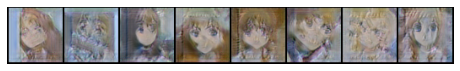

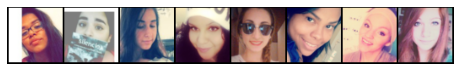

Epoch 23, Iteration 410, discriminator loss = 0.0176, generator loss = 41.6930
Epoch 23, Iteration 420, discriminator loss = 0.1588, generator loss = 43.5280
Epoch 24, Iteration 0, discriminator loss = 0.1613, generator loss = 48.1340


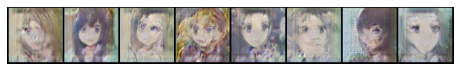

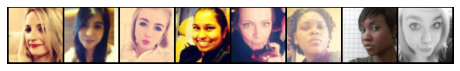

Epoch 24, Iteration 10, discriminator loss = 0.0520, generator loss = 46.7528
Epoch 24, Iteration 20, discriminator loss = 0.0328, generator loss = 46.0239
Epoch 24, Iteration 30, discriminator loss = 0.4870, generator loss = 39.5343
Epoch 24, Iteration 40, discriminator loss = 0.2979, generator loss = 41.4075
Epoch 24, Iteration 50, discriminator loss = 0.0039, generator loss = 43.6242
Epoch 24, Iteration 60, discriminator loss = 0.4574, generator loss = 40.3388
Epoch 24, Iteration 70, discriminator loss = 0.0929, generator loss = 43.5523
Epoch 24, Iteration 80, discriminator loss = 0.0445, generator loss = 41.1727
Epoch 24, Iteration 90, discriminator loss = 0.0069, generator loss = 42.6016
Epoch 24, Iteration 100, discriminator loss = 0.0095, generator loss = 43.6149


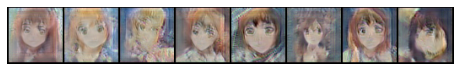

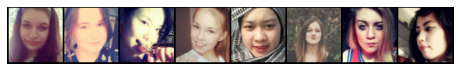

Epoch 24, Iteration 110, discriminator loss = 0.5746, generator loss = 43.0164
Epoch 24, Iteration 120, discriminator loss = 0.0743, generator loss = 44.6314
Epoch 24, Iteration 130, discriminator loss = 0.0862, generator loss = 43.5704
Epoch 24, Iteration 140, discriminator loss = 0.0321, generator loss = 44.7929
Epoch 24, Iteration 150, discriminator loss = 0.3009, generator loss = 45.1857
Epoch 24, Iteration 160, discriminator loss = 0.0114, generator loss = 40.5161
Epoch 24, Iteration 170, discriminator loss = 0.1078, generator loss = 44.9466
Epoch 24, Iteration 180, discriminator loss = 0.1008, generator loss = 46.5629
Epoch 24, Iteration 190, discriminator loss = 0.0122, generator loss = 42.8469
Epoch 24, Iteration 200, discriminator loss = 0.0544, generator loss = 41.4399


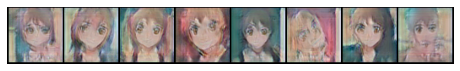

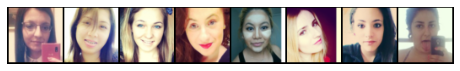

Epoch 24, Iteration 210, discriminator loss = 0.0562, generator loss = 48.3325
Epoch 24, Iteration 220, discriminator loss = 0.1736, generator loss = 37.2797
Epoch 24, Iteration 230, discriminator loss = 0.0341, generator loss = 45.9391
Epoch 24, Iteration 240, discriminator loss = 0.0992, generator loss = 33.6189
Epoch 24, Iteration 250, discriminator loss = 0.1875, generator loss = 52.4171
Epoch 24, Iteration 260, discriminator loss = 0.1482, generator loss = 38.0081
Epoch 24, Iteration 270, discriminator loss = 0.0055, generator loss = 49.3865
Epoch 24, Iteration 280, discriminator loss = 0.9041, generator loss = 39.7345
Epoch 24, Iteration 290, discriminator loss = 0.1109, generator loss = 47.5105
Epoch 24, Iteration 300, discriminator loss = 0.4858, generator loss = 43.0320


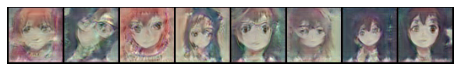

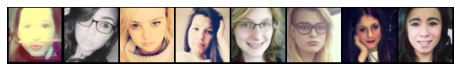

Epoch 24, Iteration 310, discriminator loss = 0.1714, generator loss = 39.4286
Epoch 24, Iteration 320, discriminator loss = 0.0637, generator loss = 40.5657
Epoch 24, Iteration 330, discriminator loss = 0.2640, generator loss = 44.7175
Epoch 24, Iteration 340, discriminator loss = 0.2697, generator loss = 37.8398
Epoch 24, Iteration 350, discriminator loss = 0.5222, generator loss = 49.0407
Epoch 24, Iteration 360, discriminator loss = 1.5333, generator loss = 55.9471
Epoch 24, Iteration 370, discriminator loss = 1.2555, generator loss = 41.5856
Epoch 24, Iteration 380, discriminator loss = 1.3666, generator loss = 41.4233
Epoch 24, Iteration 390, discriminator loss = 0.6383, generator loss = 42.0839
Epoch 24, Iteration 400, discriminator loss = 0.0340, generator loss = 42.4005


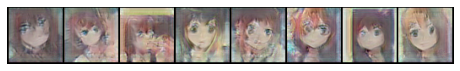

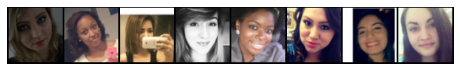

Epoch 24, Iteration 410, discriminator loss = 0.9646, generator loss = 33.7059
Epoch 24, Iteration 420, discriminator loss = 0.1101, generator loss = 45.4815
Epoch 25, Iteration 0, discriminator loss = 0.0972, generator loss = 41.0696


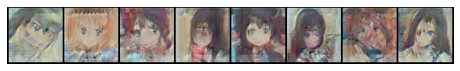

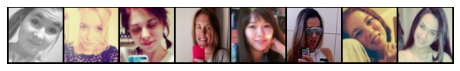

Epoch 25, Iteration 10, discriminator loss = 0.0319, generator loss = 40.3964
Epoch 25, Iteration 20, discriminator loss = 0.0640, generator loss = 38.5737
Epoch 25, Iteration 30, discriminator loss = 0.0126, generator loss = 40.4923
Epoch 25, Iteration 40, discriminator loss = 0.5206, generator loss = 39.4086
Epoch 25, Iteration 50, discriminator loss = 0.0395, generator loss = 43.9689
Epoch 25, Iteration 60, discriminator loss = 0.0045, generator loss = 43.5905
Epoch 25, Iteration 70, discriminator loss = 0.0284, generator loss = 38.0533
Epoch 25, Iteration 80, discriminator loss = 1.4901, generator loss = 40.2137
Epoch 25, Iteration 90, discriminator loss = 0.6418, generator loss = 43.2574
Epoch 25, Iteration 100, discriminator loss = 0.0266, generator loss = 43.2530


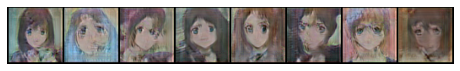

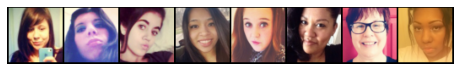

Epoch 25, Iteration 110, discriminator loss = 0.0966, generator loss = 44.9331
Epoch 25, Iteration 120, discriminator loss = 0.0830, generator loss = 35.3680
Epoch 25, Iteration 130, discriminator loss = 0.0430, generator loss = 38.1159
Epoch 25, Iteration 140, discriminator loss = 0.3335, generator loss = 41.3241
Epoch 25, Iteration 150, discriminator loss = 0.6869, generator loss = 37.3529
Epoch 25, Iteration 160, discriminator loss = 0.1702, generator loss = 46.4749
Epoch 25, Iteration 170, discriminator loss = 0.0164, generator loss = 41.8390
Epoch 25, Iteration 180, discriminator loss = 0.0880, generator loss = 48.0651
Epoch 25, Iteration 190, discriminator loss = 0.0521, generator loss = 45.2845
Epoch 25, Iteration 200, discriminator loss = 0.0367, generator loss = 47.9078


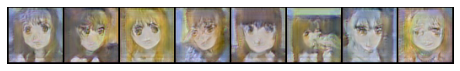

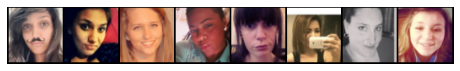

Epoch 25, Iteration 210, discriminator loss = 0.0166, generator loss = 47.2892
Epoch 25, Iteration 220, discriminator loss = 0.1538, generator loss = 46.7289
Epoch 25, Iteration 230, discriminator loss = 0.0671, generator loss = 48.8784
Epoch 25, Iteration 240, discriminator loss = 0.4535, generator loss = 45.8882
Epoch 25, Iteration 250, discriminator loss = 0.0503, generator loss = 44.6283
Epoch 25, Iteration 260, discriminator loss = 0.0106, generator loss = 43.4698
Epoch 25, Iteration 270, discriminator loss = 0.3295, generator loss = 49.2410
Epoch 25, Iteration 280, discriminator loss = 0.0207, generator loss = 42.7569
Epoch 25, Iteration 290, discriminator loss = 0.0268, generator loss = 50.0343
Epoch 25, Iteration 300, discriminator loss = 0.0978, generator loss = 50.5215


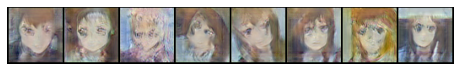

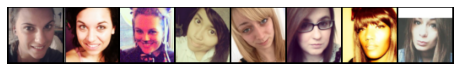

Epoch 25, Iteration 310, discriminator loss = 0.9089, generator loss = 50.7520
Epoch 25, Iteration 320, discriminator loss = 0.0179, generator loss = 41.9323
Epoch 25, Iteration 330, discriminator loss = 0.0241, generator loss = 42.3778
Epoch 25, Iteration 340, discriminator loss = 0.1923, generator loss = 38.6555
Epoch 25, Iteration 350, discriminator loss = 0.0300, generator loss = 42.8281
Epoch 25, Iteration 360, discriminator loss = 0.0161, generator loss = 49.6169
Epoch 25, Iteration 370, discriminator loss = 0.0657, generator loss = 39.6986
Epoch 25, Iteration 380, discriminator loss = 0.1758, generator loss = 46.1517
Epoch 25, Iteration 390, discriminator loss = 0.0007, generator loss = 52.0245
Epoch 25, Iteration 400, discriminator loss = 0.5249, generator loss = 40.8450


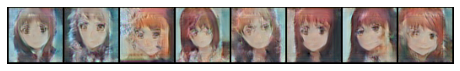

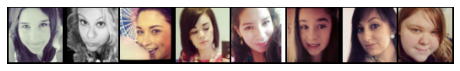

Epoch 25, Iteration 410, discriminator loss = 0.0040, generator loss = 41.5268
Epoch 25, Iteration 420, discriminator loss = 0.3381, generator loss = 34.2263
Epoch 26, Iteration 0, discriminator loss = 0.4022, generator loss = 50.8211


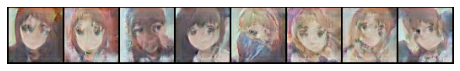

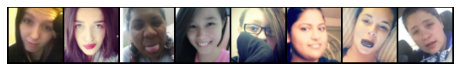

Epoch 26, Iteration 10, discriminator loss = 0.5844, generator loss = 40.0154
Epoch 26, Iteration 20, discriminator loss = 0.0131, generator loss = 42.0974
Epoch 26, Iteration 30, discriminator loss = 0.0712, generator loss = 44.3688
Epoch 26, Iteration 40, discriminator loss = 0.1705, generator loss = 41.4673
Epoch 26, Iteration 50, discriminator loss = 0.0485, generator loss = 45.3728
Epoch 26, Iteration 60, discriminator loss = 0.0217, generator loss = 51.2158
Epoch 26, Iteration 70, discriminator loss = 0.2591, generator loss = 48.5750
Epoch 26, Iteration 80, discriminator loss = 0.0464, generator loss = 42.8427
Epoch 26, Iteration 90, discriminator loss = 0.5005, generator loss = 48.0350
Epoch 26, Iteration 100, discriminator loss = 0.2222, generator loss = 40.3167


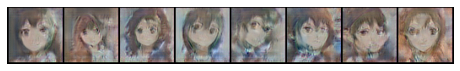

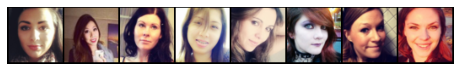

Epoch 26, Iteration 110, discriminator loss = 0.4770, generator loss = 44.4602
Epoch 26, Iteration 120, discriminator loss = 0.0876, generator loss = 41.3812
Epoch 26, Iteration 130, discriminator loss = 0.0368, generator loss = 45.4177
Epoch 26, Iteration 140, discriminator loss = 0.6261, generator loss = 48.7156
Epoch 26, Iteration 150, discriminator loss = 0.0520, generator loss = 48.2666
Epoch 26, Iteration 160, discriminator loss = 0.0417, generator loss = 42.2435
Epoch 26, Iteration 170, discriminator loss = 0.3946, generator loss = 38.8820
Epoch 26, Iteration 180, discriminator loss = 1.4991, generator loss = 37.1031
Epoch 26, Iteration 190, discriminator loss = 0.2156, generator loss = 43.8546
Epoch 26, Iteration 200, discriminator loss = 0.0295, generator loss = 46.2675


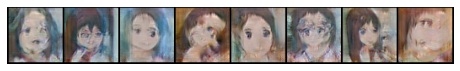

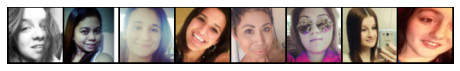

Epoch 26, Iteration 210, discriminator loss = 0.0721, generator loss = 39.4106
Epoch 26, Iteration 220, discriminator loss = 0.2546, generator loss = 43.1446
Epoch 26, Iteration 230, discriminator loss = 0.2239, generator loss = 47.0876
Epoch 26, Iteration 240, discriminator loss = 0.2771, generator loss = 46.1435
Epoch 26, Iteration 250, discriminator loss = 0.1115, generator loss = 46.0400
Epoch 26, Iteration 260, discriminator loss = 0.0419, generator loss = 43.9359
Epoch 26, Iteration 270, discriminator loss = 0.0667, generator loss = 46.2872
Epoch 26, Iteration 280, discriminator loss = 0.0229, generator loss = 45.6407
Epoch 26, Iteration 290, discriminator loss = 0.2132, generator loss = 44.4113
Epoch 26, Iteration 300, discriminator loss = 0.0392, generator loss = 38.2935


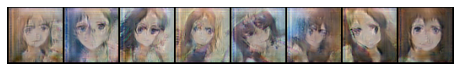

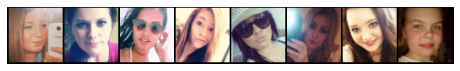

Epoch 26, Iteration 310, discriminator loss = 0.0367, generator loss = 41.2081
Epoch 26, Iteration 320, discriminator loss = 0.0648, generator loss = 40.1065
Epoch 26, Iteration 330, discriminator loss = 0.2718, generator loss = 46.2307
Epoch 26, Iteration 340, discriminator loss = 0.0806, generator loss = 47.9718
Epoch 26, Iteration 350, discriminator loss = 0.0005, generator loss = 54.1563
Epoch 26, Iteration 360, discriminator loss = 0.0829, generator loss = 39.5903
Epoch 26, Iteration 370, discriminator loss = 0.0622, generator loss = 38.1698
Epoch 26, Iteration 380, discriminator loss = 0.0318, generator loss = 41.1660
Epoch 26, Iteration 390, discriminator loss = 0.0540, generator loss = 48.9357
Epoch 26, Iteration 400, discriminator loss = 0.0033, generator loss = 42.5195


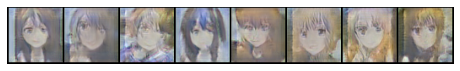

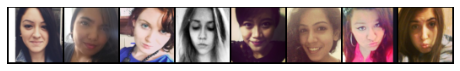

Epoch 26, Iteration 410, discriminator loss = 0.0029, generator loss = 45.5769
Epoch 26, Iteration 420, discriminator loss = 0.4025, generator loss = 48.4462
Epoch 27, Iteration 0, discriminator loss = 0.0080, generator loss = 45.8933


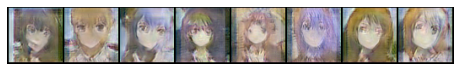

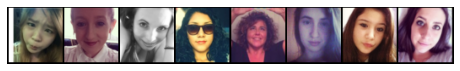

Epoch 27, Iteration 10, discriminator loss = 0.1383, generator loss = 42.3898
Epoch 27, Iteration 20, discriminator loss = 0.0893, generator loss = 35.5352
Epoch 27, Iteration 30, discriminator loss = 0.5115, generator loss = 42.7949
Epoch 27, Iteration 40, discriminator loss = 0.0423, generator loss = 49.9726
Epoch 27, Iteration 50, discriminator loss = 0.1456, generator loss = 41.0818
Epoch 27, Iteration 60, discriminator loss = 0.1813, generator loss = 35.6684
Epoch 27, Iteration 70, discriminator loss = 0.0251, generator loss = 50.7553
Epoch 27, Iteration 80, discriminator loss = 0.0489, generator loss = 49.7221
Epoch 27, Iteration 90, discriminator loss = 1.5030, generator loss = 42.8143
Epoch 27, Iteration 100, discriminator loss = 0.0269, generator loss = 42.0465


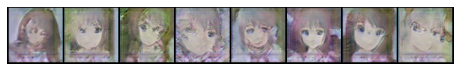

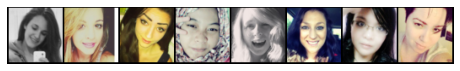

Epoch 27, Iteration 110, discriminator loss = 0.4965, generator loss = 44.3443
Epoch 27, Iteration 120, discriminator loss = 0.0051, generator loss = 41.0925
Epoch 27, Iteration 130, discriminator loss = 0.0434, generator loss = 39.2690
Epoch 27, Iteration 140, discriminator loss = 0.0537, generator loss = 39.6457
Epoch 27, Iteration 150, discriminator loss = 0.1360, generator loss = 48.1994
Epoch 27, Iteration 160, discriminator loss = 0.0233, generator loss = 38.5396
Epoch 27, Iteration 170, discriminator loss = 0.0759, generator loss = 44.2387
Epoch 27, Iteration 180, discriminator loss = 0.0723, generator loss = 45.5482
Epoch 27, Iteration 190, discriminator loss = 0.0126, generator loss = 44.1370
Epoch 27, Iteration 200, discriminator loss = 0.0053, generator loss = 45.1590


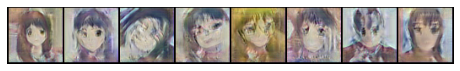

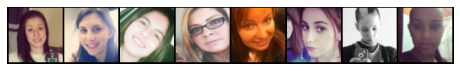

Epoch 27, Iteration 210, discriminator loss = 0.0097, generator loss = 43.0899
Epoch 27, Iteration 220, discriminator loss = 0.2348, generator loss = 37.1321
Epoch 27, Iteration 230, discriminator loss = 0.0470, generator loss = 54.0423
Epoch 27, Iteration 240, discriminator loss = 0.0787, generator loss = 44.6646
Epoch 27, Iteration 250, discriminator loss = 0.0318, generator loss = 49.7852
Epoch 27, Iteration 260, discriminator loss = 0.1520, generator loss = 36.6318
Epoch 27, Iteration 270, discriminator loss = 0.3438, generator loss = 39.2642
Epoch 27, Iteration 280, discriminator loss = 0.2492, generator loss = 37.5711
Epoch 27, Iteration 290, discriminator loss = 0.0122, generator loss = 35.8426
Epoch 27, Iteration 300, discriminator loss = 0.0730, generator loss = 39.2102


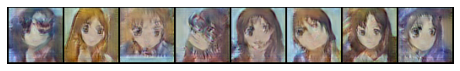

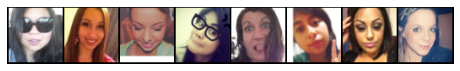

Epoch 27, Iteration 310, discriminator loss = 0.9666, generator loss = 54.8030
Epoch 27, Iteration 320, discriminator loss = 0.1800, generator loss = 42.1776
Epoch 27, Iteration 330, discriminator loss = 0.0133, generator loss = 39.7647
Epoch 27, Iteration 340, discriminator loss = 0.6644, generator loss = 42.0405
Epoch 27, Iteration 350, discriminator loss = 0.0038, generator loss = 42.2143
Epoch 27, Iteration 360, discriminator loss = 0.1737, generator loss = 36.2142
Epoch 27, Iteration 370, discriminator loss = 0.1842, generator loss = 50.6812
Epoch 27, Iteration 380, discriminator loss = 0.1285, generator loss = 45.7836
Epoch 27, Iteration 390, discriminator loss = 0.5328, generator loss = 43.6877
Epoch 27, Iteration 400, discriminator loss = 0.1687, generator loss = 43.0585


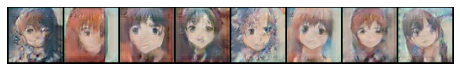

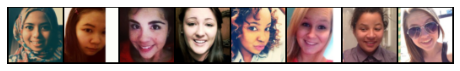

Epoch 27, Iteration 410, discriminator loss = 0.1405, generator loss = 37.5564
Epoch 27, Iteration 420, discriminator loss = 0.2602, generator loss = 44.1782
Epoch 28, Iteration 0, discriminator loss = 0.0064, generator loss = 39.9747


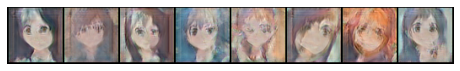

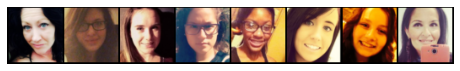

Epoch 28, Iteration 10, discriminator loss = 0.0419, generator loss = 43.9559
Epoch 28, Iteration 20, discriminator loss = 0.1764, generator loss = 36.8468
Epoch 28, Iteration 30, discriminator loss = 0.4240, generator loss = 37.9350
Epoch 28, Iteration 40, discriminator loss = 0.0587, generator loss = 41.2676
Epoch 28, Iteration 50, discriminator loss = 0.2634, generator loss = 50.1411
Epoch 28, Iteration 60, discriminator loss = 0.1266, generator loss = 41.3794
Epoch 28, Iteration 70, discriminator loss = 0.0275, generator loss = 47.8117
Epoch 28, Iteration 80, discriminator loss = 0.4748, generator loss = 47.2566
Epoch 28, Iteration 90, discriminator loss = 0.1728, generator loss = 39.6036
Epoch 28, Iteration 100, discriminator loss = 0.3087, generator loss = 39.9243


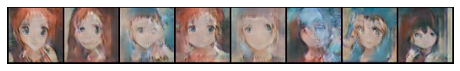

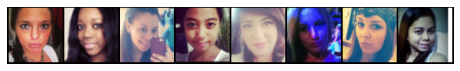

Epoch 28, Iteration 110, discriminator loss = 0.0328, generator loss = 45.5160
Epoch 28, Iteration 120, discriminator loss = 0.0660, generator loss = 42.1928
Epoch 28, Iteration 130, discriminator loss = 0.0662, generator loss = 37.6756
Epoch 28, Iteration 140, discriminator loss = 0.6165, generator loss = 49.5396
Epoch 28, Iteration 150, discriminator loss = 0.0319, generator loss = 43.8833
Epoch 28, Iteration 160, discriminator loss = 0.0862, generator loss = 40.6591
Epoch 28, Iteration 170, discriminator loss = 0.2079, generator loss = 46.4719
Epoch 28, Iteration 180, discriminator loss = 0.0177, generator loss = 42.7983
Epoch 28, Iteration 190, discriminator loss = 0.1520, generator loss = 50.2130
Epoch 28, Iteration 200, discriminator loss = 0.2595, generator loss = 47.2987


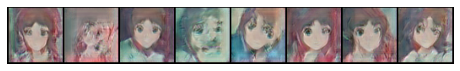

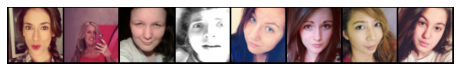

Epoch 28, Iteration 210, discriminator loss = 0.2668, generator loss = 32.4683
Epoch 28, Iteration 220, discriminator loss = 0.1332, generator loss = 36.9437
Epoch 28, Iteration 230, discriminator loss = 0.2054, generator loss = 51.2354
Epoch 28, Iteration 240, discriminator loss = 0.0099, generator loss = 36.5421
Epoch 28, Iteration 250, discriminator loss = 0.2604, generator loss = 43.4185
Epoch 28, Iteration 260, discriminator loss = 0.0091, generator loss = 45.6092
Epoch 28, Iteration 270, discriminator loss = 0.0267, generator loss = 42.7486
Epoch 28, Iteration 280, discriminator loss = 0.0571, generator loss = 45.4989
Epoch 28, Iteration 290, discriminator loss = 0.0296, generator loss = 44.1482
Epoch 28, Iteration 300, discriminator loss = 0.0070, generator loss = 46.7287


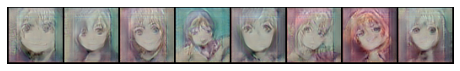

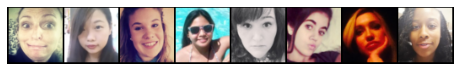

Epoch 28, Iteration 310, discriminator loss = 0.0632, generator loss = 42.2453
Epoch 28, Iteration 320, discriminator loss = 0.0277, generator loss = 44.9224
Epoch 28, Iteration 330, discriminator loss = 0.0136, generator loss = 45.0101
Epoch 28, Iteration 340, discriminator loss = 0.0194, generator loss = 42.3221
Epoch 28, Iteration 350, discriminator loss = 0.0113, generator loss = 43.6663
Epoch 28, Iteration 360, discriminator loss = 0.1867, generator loss = 45.4799
Epoch 28, Iteration 370, discriminator loss = 0.0045, generator loss = 46.4308
Epoch 28, Iteration 380, discriminator loss = 0.0470, generator loss = 38.4120
Epoch 28, Iteration 390, discriminator loss = 0.8167, generator loss = 39.5182
Epoch 28, Iteration 400, discriminator loss = 0.7702, generator loss = 40.5875


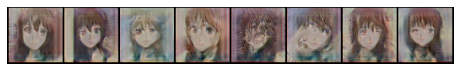

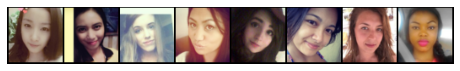

Epoch 28, Iteration 410, discriminator loss = 0.0291, generator loss = 39.0514
Epoch 28, Iteration 420, discriminator loss = 0.0512, generator loss = 41.1778
Epoch 29, Iteration 0, discriminator loss = 0.1217, generator loss = 36.0006


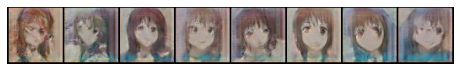

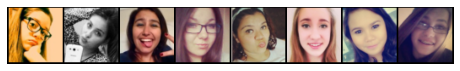

Epoch 29, Iteration 10, discriminator loss = 0.0177, generator loss = 41.8200
Epoch 29, Iteration 20, discriminator loss = 0.0325, generator loss = 44.1596
Epoch 29, Iteration 30, discriminator loss = 0.0431, generator loss = 38.6625
Epoch 29, Iteration 40, discriminator loss = 0.1821, generator loss = 45.3378
Epoch 29, Iteration 50, discriminator loss = 0.1228, generator loss = 42.6902
Epoch 29, Iteration 60, discriminator loss = 0.5477, generator loss = 40.9780
Epoch 29, Iteration 70, discriminator loss = 0.0263, generator loss = 40.4191
Epoch 29, Iteration 80, discriminator loss = 0.4771, generator loss = 42.1817
Epoch 29, Iteration 90, discriminator loss = 0.1508, generator loss = 42.7284
Epoch 29, Iteration 100, discriminator loss = 0.0053, generator loss = 41.7756


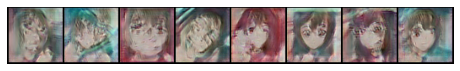

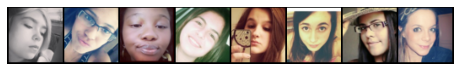

Epoch 29, Iteration 110, discriminator loss = 0.9665, generator loss = 43.4822
Epoch 29, Iteration 120, discriminator loss = 0.0050, generator loss = 49.6637
Epoch 29, Iteration 130, discriminator loss = 0.1365, generator loss = 40.8162
Epoch 29, Iteration 140, discriminator loss = 0.0505, generator loss = 37.6509
Epoch 29, Iteration 150, discriminator loss = 0.0137, generator loss = 39.7725
Epoch 29, Iteration 160, discriminator loss = 0.2404, generator loss = 48.9191
Epoch 29, Iteration 170, discriminator loss = 0.0153, generator loss = 43.1874
Epoch 29, Iteration 180, discriminator loss = 0.0132, generator loss = 41.1244
Epoch 29, Iteration 190, discriminator loss = 0.0171, generator loss = 38.4470
Epoch 29, Iteration 200, discriminator loss = 0.0096, generator loss = 44.2945


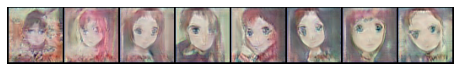

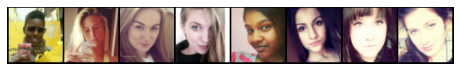

Epoch 29, Iteration 210, discriminator loss = 0.0108, generator loss = 42.3429
Epoch 29, Iteration 220, discriminator loss = 0.0243, generator loss = 39.6728
Epoch 29, Iteration 230, discriminator loss = 0.4445, generator loss = 37.6242
Epoch 29, Iteration 240, discriminator loss = 0.4689, generator loss = 39.7499
Epoch 29, Iteration 250, discriminator loss = 0.0415, generator loss = 40.5420
Epoch 29, Iteration 260, discriminator loss = 0.0289, generator loss = 43.4539
Epoch 29, Iteration 270, discriminator loss = 0.0326, generator loss = 48.4614
Epoch 29, Iteration 280, discriminator loss = 1.4745, generator loss = 53.5576
Epoch 29, Iteration 290, discriminator loss = 0.0033, generator loss = 53.7146
Epoch 29, Iteration 300, discriminator loss = 0.1845, generator loss = 35.3961


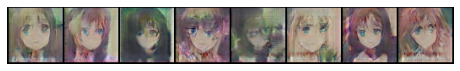

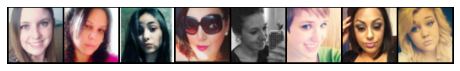

Epoch 29, Iteration 310, discriminator loss = 0.2419, generator loss = 48.1338
Epoch 29, Iteration 320, discriminator loss = 0.0195, generator loss = 47.4754
Epoch 29, Iteration 330, discriminator loss = 0.0077, generator loss = 42.5607
Epoch 29, Iteration 340, discriminator loss = 0.2038, generator loss = 35.5483
Epoch 29, Iteration 350, discriminator loss = 0.4399, generator loss = 42.4578
Epoch 29, Iteration 360, discriminator loss = 0.2353, generator loss = 35.4998
Epoch 29, Iteration 370, discriminator loss = 0.0444, generator loss = 37.1168
Epoch 29, Iteration 380, discriminator loss = 0.1179, generator loss = 40.6312
Epoch 29, Iteration 390, discriminator loss = 1.2221, generator loss = 44.9740
Epoch 29, Iteration 400, discriminator loss = 0.0772, generator loss = 38.9759


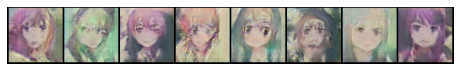

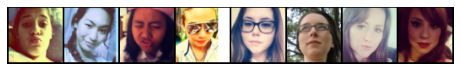

Epoch 29, Iteration 410, discriminator loss = 1.0882, generator loss = 47.4917
Epoch 29, Iteration 420, discriminator loss = 0.0412, generator loss = 40.1006
Epoch 30, Iteration 0, discriminator loss = 0.0244, generator loss = 40.5050


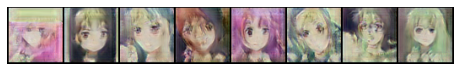

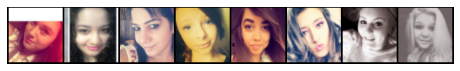

Epoch 30, Iteration 10, discriminator loss = 0.0573, generator loss = 46.0220
Epoch 30, Iteration 20, discriminator loss = 0.1091, generator loss = 45.1226
Epoch 30, Iteration 30, discriminator loss = 0.0667, generator loss = 41.4557
Epoch 30, Iteration 40, discriminator loss = 0.3041, generator loss = 44.0053
Epoch 30, Iteration 50, discriminator loss = 0.0975, generator loss = 38.4653
Epoch 30, Iteration 60, discriminator loss = 0.1209, generator loss = 45.7358
Epoch 30, Iteration 70, discriminator loss = 0.0630, generator loss = 56.2312
Epoch 30, Iteration 80, discriminator loss = 0.1776, generator loss = 43.9596
Epoch 30, Iteration 90, discriminator loss = 0.0355, generator loss = 42.2858
Epoch 30, Iteration 100, discriminator loss = 0.1017, generator loss = 38.3036


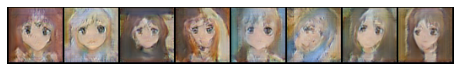

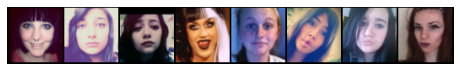

Epoch 30, Iteration 110, discriminator loss = 0.0965, generator loss = 51.9521
Epoch 30, Iteration 120, discriminator loss = 0.3839, generator loss = 49.1068
Epoch 30, Iteration 130, discriminator loss = 0.0246, generator loss = 41.3634
Epoch 30, Iteration 140, discriminator loss = 0.0868, generator loss = 38.8621
Epoch 30, Iteration 150, discriminator loss = 0.0622, generator loss = 40.7971
Epoch 30, Iteration 160, discriminator loss = 0.0557, generator loss = 44.4803
Epoch 30, Iteration 170, discriminator loss = 0.0256, generator loss = 42.6476
Epoch 30, Iteration 180, discriminator loss = 0.0546, generator loss = 48.0925
Epoch 30, Iteration 190, discriminator loss = 0.0252, generator loss = 37.2041
Epoch 30, Iteration 200, discriminator loss = 0.0419, generator loss = 41.4852


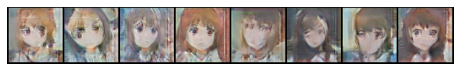

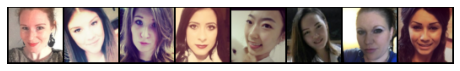

Epoch 30, Iteration 210, discriminator loss = 0.0048, generator loss = 48.2852
Epoch 30, Iteration 220, discriminator loss = 0.0069, generator loss = 39.1097
Epoch 30, Iteration 230, discriminator loss = 0.2250, generator loss = 36.5486
Epoch 30, Iteration 240, discriminator loss = 0.0035, generator loss = 40.1802
Epoch 30, Iteration 250, discriminator loss = 0.0865, generator loss = 49.2289
Epoch 30, Iteration 260, discriminator loss = 0.0494, generator loss = 47.3141
Epoch 30, Iteration 270, discriminator loss = 0.0721, generator loss = 33.8187
Epoch 30, Iteration 280, discriminator loss = 0.2026, generator loss = 41.1704
Epoch 30, Iteration 290, discriminator loss = 0.1041, generator loss = 39.3295
Epoch 30, Iteration 300, discriminator loss = 0.0529, generator loss = 42.0888


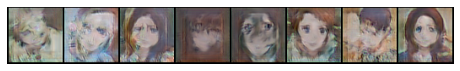

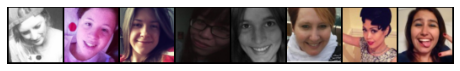

Epoch 30, Iteration 310, discriminator loss = 0.2880, generator loss = 40.9408
Epoch 30, Iteration 320, discriminator loss = 0.1903, generator loss = 43.7814
Epoch 30, Iteration 330, discriminator loss = 0.0040, generator loss = 38.2178
Epoch 30, Iteration 340, discriminator loss = 0.0599, generator loss = 36.6791
Epoch 30, Iteration 350, discriminator loss = 0.0360, generator loss = 48.0880
Epoch 30, Iteration 360, discriminator loss = 0.0661, generator loss = 35.7483
Epoch 30, Iteration 370, discriminator loss = 0.4127, generator loss = 35.7370
Epoch 30, Iteration 380, discriminator loss = 0.0044, generator loss = 42.3323
Epoch 30, Iteration 390, discriminator loss = 0.4846, generator loss = 40.0830
Epoch 30, Iteration 400, discriminator loss = 0.0215, generator loss = 47.6558


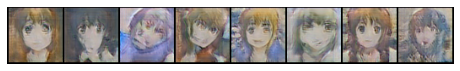

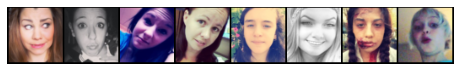

Epoch 30, Iteration 410, discriminator loss = 0.1710, generator loss = 41.4382
Epoch 30, Iteration 420, discriminator loss = 0.0038, generator loss = 40.3304


In [ ]:
# training 

import itertools
netD_s = Discriminator()
netD_a = Discriminator2()
netG_s = GenResNet()
netG_a = GenResNet2()
beta1 = 0.5
lambda_a = 20
lambda_s = 100
optimizer_da = optim.Adam(netD_a.parameters(), lr=0.0002, betas=(beta1, 0.999))
optimizer_ds = optim.Adam(netD_s.parameters(), lr=0.0002, betas=(beta1, 0.999))
optimizer_ga = optim.Adam(netG_a.parameters(), lr=0.0002, betas=(beta1, 0.999))
optimizer_gs = optim.Adam(netG_s.parameters(), lr=0.0002, betas=(beta1, 0.999))

da_loss_eps, ds_loss_eps, ga_loss_eps, gs_loss_eps = train(loader_train_self, loader_train_self, loader_train_anime, loader_train_anime, netD_s, netD_a, netG_s, netG_a, optimizer_da, optimizer_ds, optimizer_ga, optimizer_gs, epochs = 30)
# test(loader_test_anime, loader_test_self, netG_s)

# Testing


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FID score:  112.66046708255135
Here are some selfies


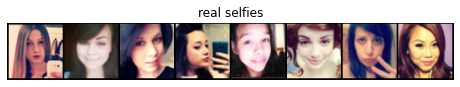

Here are some fake anime from selfies
Here are some fake selfies from fake animes


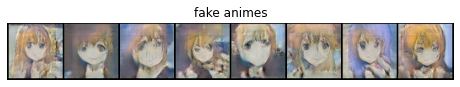

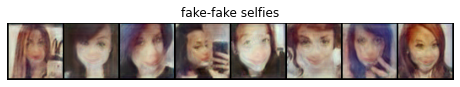

Here are some selfies


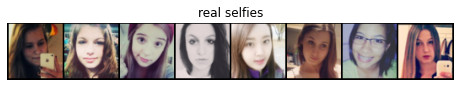

Here are some fake anime from selfies
Here are some fake selfies from fake animes


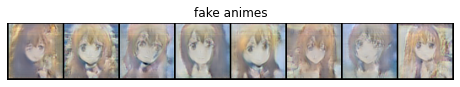

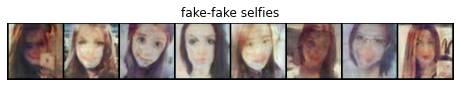

Here are some selfies


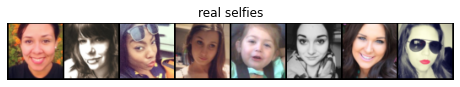

Here are some fake anime from selfies
Here are some fake selfies from fake animes


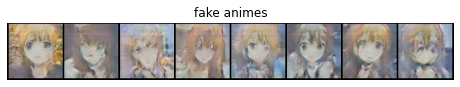

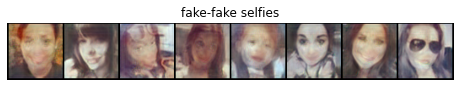

Here are some selfies


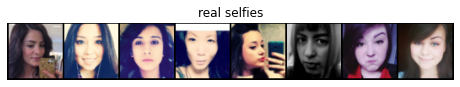

Here are some fake anime from selfies
Here are some fake selfies from fake animes


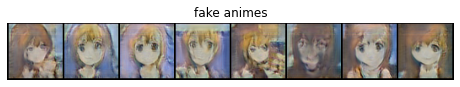

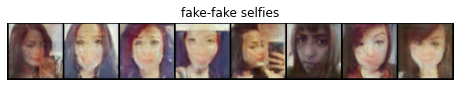

Here are some selfies


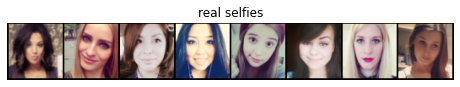

Here are some fake anime from selfies
Here are some fake selfies from fake animes


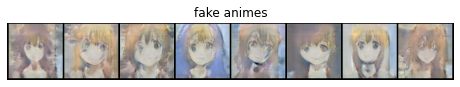

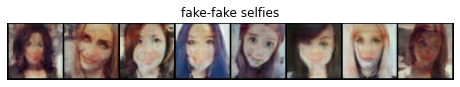

Here are some selfies


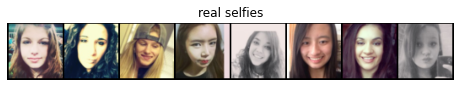

Here are some fake anime from selfies
Here are some fake selfies from fake animes


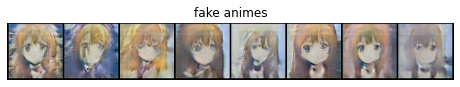

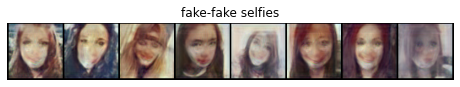

Here are some selfies


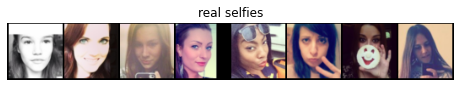

Here are some fake anime from selfies
Here are some fake selfies from fake animes


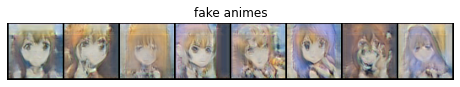

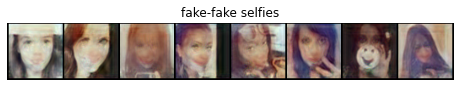

Here are some selfies


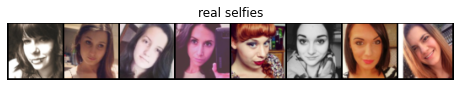

Here are some fake anime from selfies
Here are some fake selfies from fake animes


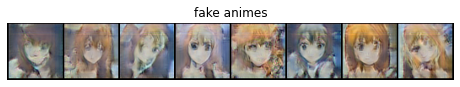

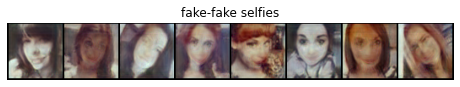

Here are some selfies


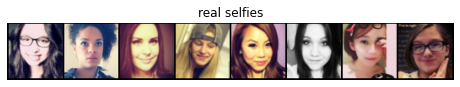

Here are some fake anime from selfies
Here are some fake selfies from fake animes


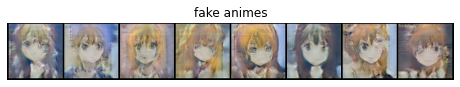

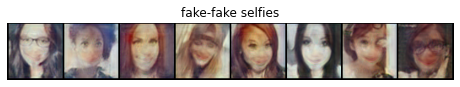

Here are some selfies


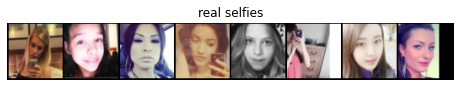

Here are some fake anime from selfies
Here are some fake selfies from fake animes


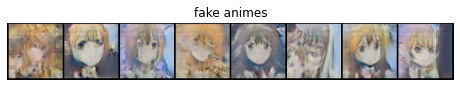

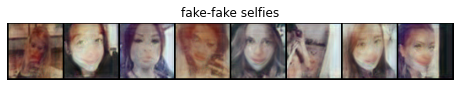

Here are some selfies


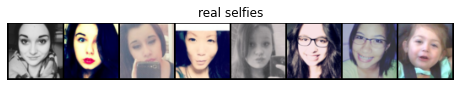

Here are some fake anime from selfies
Here are some fake selfies from fake animes


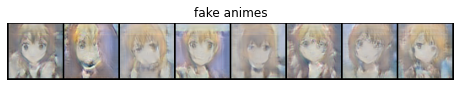

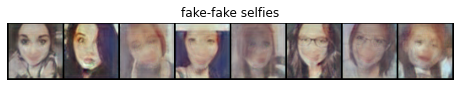

Here are some selfies


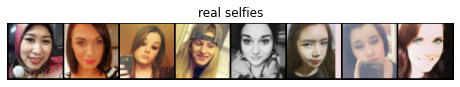

Here are some fake anime from selfies
Here are some fake selfies from fake animes


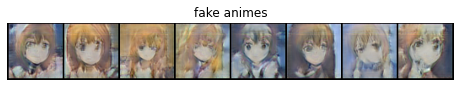

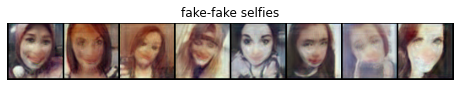

Here are some selfies


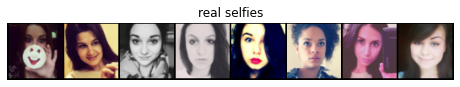

Here are some fake anime from selfies
Here are some fake selfies from fake animes


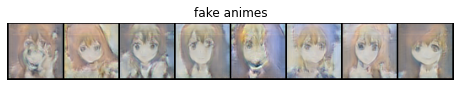

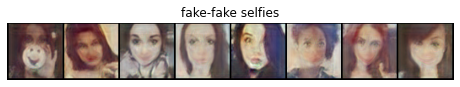

In [ ]:
# testing to get FID score
test(loader_test_anime, loader_test_self, netG_s)

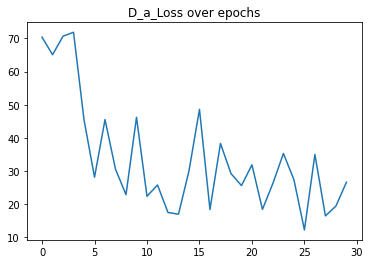

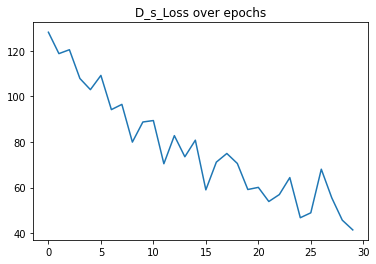

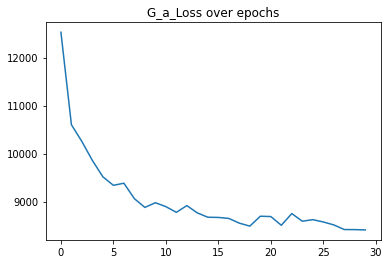

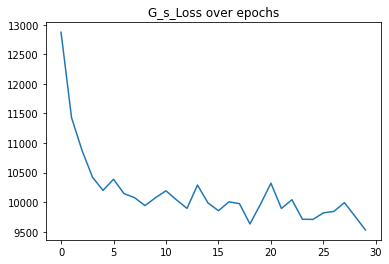

In [ ]:
# plot the loss functions of D's and G's 

plt.plot(np.arange(30), np.array(da_loss_eps))
plt.title("D_a_Loss over epochs")
plt.show()
plt.close()

plt.plot(np.arange(30), np.array(ds_loss_eps))
plt.title("D_s_Loss over epochs")
plt.show()
plt.close()

plt.plot(np.arange(30), np.array(ga_loss_eps))
plt.title("G_a_Loss over epochs")
plt.show()
plt.close()

plt.plot(np.arange(30), np.array(gs_loss_eps))
plt.title("G_s_Loss over epochs")
plt.show()
plt.close()